<a href="https://colab.research.google.com/github/PrasunDatta/SIIM-ISIC-Melanoma-Classification_2020/blob/main/melanoma_classification_data_visualization_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

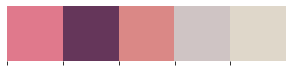

In [ ]:
#Regular imports
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tabulate import tabulate
import missingno as msno #need to see
from IPython.display import display_html
from PIL import Image
import gc #need to see
import cv2
from sklearn.preprocessing import LabelEncoder

import pydicom #for DICOM images
from skimage.transform import resize

import warnings #need to see
warnings.filterwarnings("ignore")

#set colour palettes for the notebook
colors_nude = ['#e0798c','#65365a','#da8886','#cfc4c4','#dfd7ca']
sns.palplot(sns.color_palette(colors_nude))

#set style
sns.set_style("whitegrid")
sns.despine(left = True, bottom = True) # need to see

In [ ]:
list(sorted(os.listdir("../input/siim-isic-melanoma-classification")))

['jpeg',
 'sample_submission.csv',
 'test',
 'test.csv',
 'tfrecords',
 'train',
 'train.csv']

# 3.CSV Files_Train & Test

In [ ]:
#directory
directory = "../input/siim-isic-melanoma-classification"
#import the 2 csv 
train_df = pd.read_csv(directory + "/train.csv")
train_df

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
0,ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,benign,0
1,ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,benign,0
2,ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,benign,0
3,ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,benign,0
4,ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,benign,0
...,...,...,...,...,...,...,...,...
33121,ISIC_9999134,IP_6526534,male,50.0,torso,unknown,benign,0
33122,ISIC_9999320,IP_3650745,male,65.0,torso,unknown,benign,0
33123,ISIC_9999515,IP_2026598,male,20.0,lower extremity,unknown,benign,0
33124,ISIC_9999666,IP_7702038,male,50.0,lower extremity,unknown,benign,0


In [ ]:
test_df = pd.read_csv(directory + "/test.csv")
test_df

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge
0,ISIC_0052060,IP_3579794,male,70.0,NaN
1,ISIC_0052349,IP_7782715,male,40.0,lower extremity
2,ISIC_0058510,IP_7960270,female,55.0,torso
3,ISIC_0073313,IP_6375035,female,50.0,torso
4,ISIC_0073502,IP_0589375,female,45.0,lower extremity
...,...,...,...,...,...
10977,ISIC_9992485,IP_4152479,male,40.0,torso
10978,ISIC_9996992,IP_4890115,male,35.0,torso
10979,ISIC_9997917,IP_2852390,male,25.0,upper extremity
10980,ISIC_9998234,IP_8861963,male,65.0,lower extremity


In [ ]:
print("Train has {:,} rows and Test has {:,} rows.".format(len(train_df),len(test_df)))

#change column names
new_names = ["dcm_name","ID","sex","age","anatomy","diagnosis","benign_malignant","target"]
#new_names[0:5]
train_df.columns = new_names
test_df.columns = new_names[:5]
test_df.columns

Train has 33,126 rows and Test has 10,982 rows.


Index(['dcm_name', 'ID', 'sex', 'age', 'anatomy'], dtype='object')

Text(0.5, 1.0, 'Test Missing Values Map')

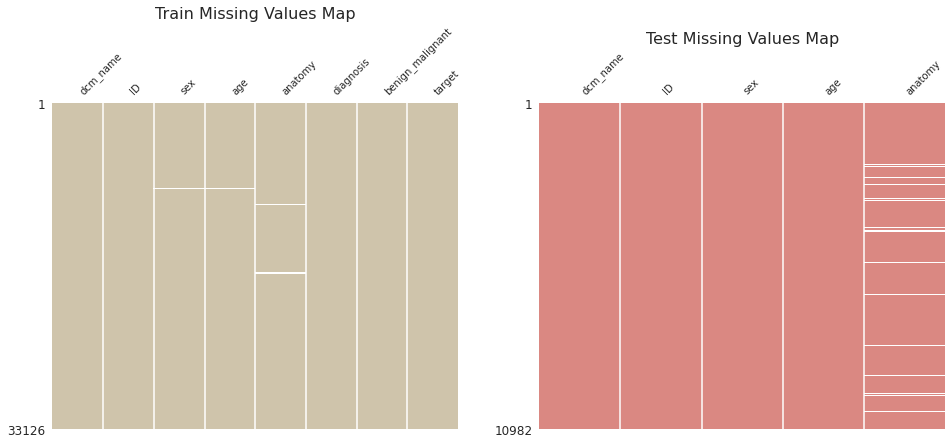

In [ ]:
f,(ax1,ax2) = plt.subplots(1,2,figsize =(16,6))
msno.matrix(train_df,ax = ax1,color = (207/255,196/255,171/255),fontsize = 10)
msno.matrix(test_df, ax = ax2, color = (218/255,136/255, 130/255), fontsize = 10)

ax1.set_title("Train Missing Values Map", fontsize = 16)
ax2.set_title("Test Missing Values Map" , fontsize = 16)

Number of NaN values in Sex Column is :65
Number of Existing values in Sex Column is: 33061
Out of 65 NaN values,65 are benign and 0 malignant


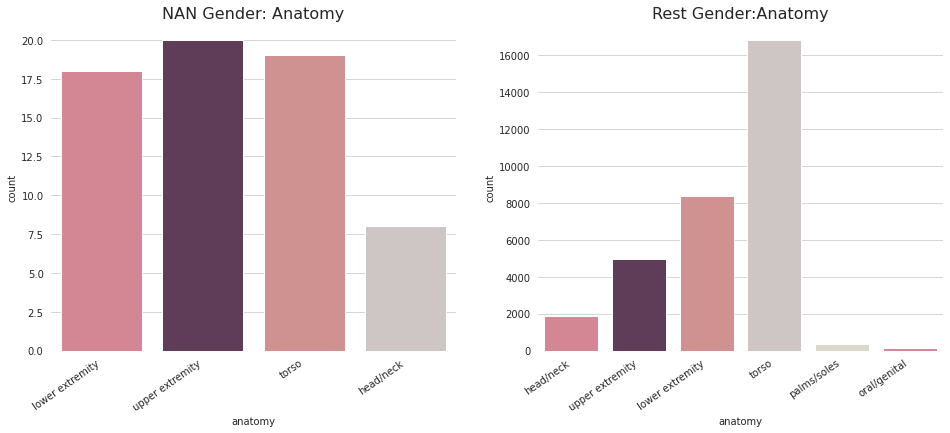

In [ ]:
nan_sex = train_df[train_df['sex'].isna() == True]
print(f"Number of NaN values in Sex Column is :{nan_sex.shape[0]}")
is_sex = train_df[train_df['sex'].isna()==False]
print(f"Number of Existing values in Sex Column is: {is_sex.shape[0]}")
#figure 
f, (ax1, ax2) = plt.subplots(1,2,figsize = (16,6))

a = sns.countplot(nan_sex["anatomy"], ax = ax1, palette = colors_nude)
b = sns.countplot(is_sex["anatomy"], ax = ax2, palette = colors_nude)
ax1.set_title("NAN Gender: Anatomy", fontsize = 16)
ax2.set_title("Rest Gender:Anatomy", fontsize = 16)

a.set_xticklabels(a.get_xticklabels(), rotation = 35,ha = "right")
b.set_xticklabels(b.get_xticklabels(), rotation = 35, ha = "right")

sns.despine(left = True, bottom = True)

no_benign = nan_sex["benign_malignant"].value_counts()[0]
#Benign and malignant check
print(f"Out of 65 NaN values,{no_benign} are benign and 0 malignant")

In [ ]:
#check how many are makes and how many are females
anatomy = ["lower extremity","upper extremity","torso"]
train_df[train_df["anatomy"].isin(anatomy) & (train_df["target"]==0)]["sex"].value_counts()

#impute the missing values with male
train_df["sex"].fillna("male", inplace = True)

# Train: AGE Variable

Out of 65 NaN values,68 are benign and 0 malignant


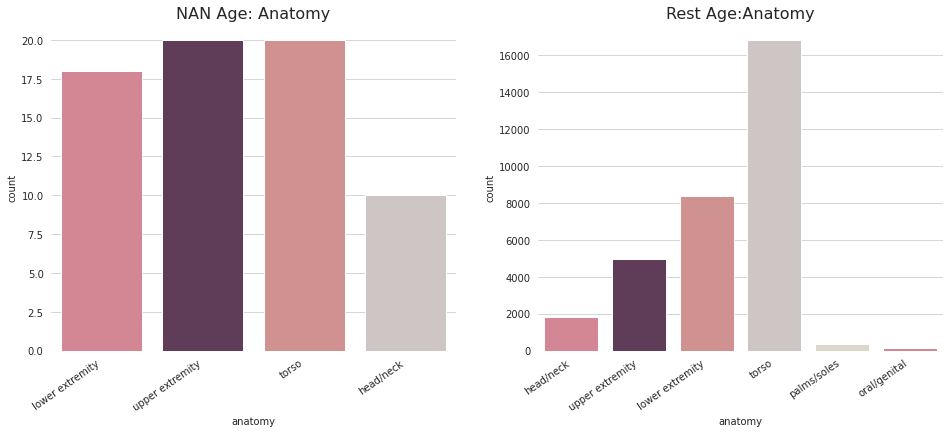

In [ ]:
nan_age = train_df[train_df["age"].isna()== True]
is_age = train_df[train_df["age"].isna() == False]

#Figure
f,(ax1,ax2) = plt.subplots(1,2,figsize = (16,6))

a = sns.countplot(nan_age["anatomy"], ax = ax1, palette = colors_nude)
b = sns.countplot(is_age["anatomy"], ax = ax2, palette = colors_nude)
ax1.set_title("NAN Age: Anatomy", fontsize = 16)
ax2.set_title("Rest Age:Anatomy", fontsize = 16)

a.set_xticklabels(a.get_xticklabels(), rotation = 35,ha = "right")
b.set_xticklabels(b.get_xticklabels(), rotation = 35, ha = "right")

sns.despine(left = True, bottom = True)

no_benign = nan_age["benign_malignant"].value_counts()[0]
#Benign and malignant check
print(f"Out of 65 NaN values,{no_benign} are benign and 0 malignant")


In [ ]:
#check the mean age
anatomy = ["lower extremity", "upper extremity", "torso"]

median = train_df[(train_df["anatomy"].isin(anatomy)) & (train_df["target"]==0) & (train_df["sex"] == "male")]["age"].median()
print("Median is: " , median)

train_df['age'].fillna(median, inplace = True)

Median is:  50.0


# Train: Anatomy Variable

From all missing values,518 are benign and 9 are malignant


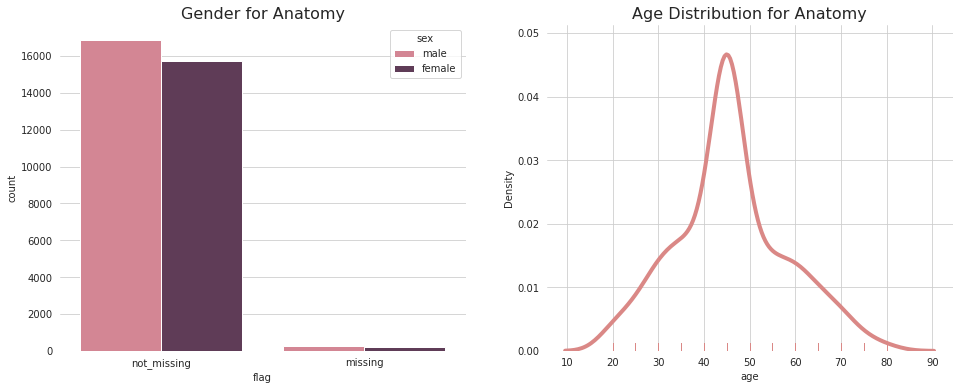

In [ ]:
anatomy = train_df.copy()
anatomy['flag'] = np.where(train_df['anatomy'].isna()== True, "missing","not_missing")

#figure
f, (ax1, ax2) = plt.subplots(1,2, figsize = (16,6))
sns.countplot(anatomy['flag'], hue = anatomy['sex'], ax = ax1 , palette = colors_nude)


sns.distplot(anatomy[anatomy['flag']== 'missing']['age'], hist = False,rug=True,label="Missing",ax = ax2, color = colors_nude[2],kde_kws=dict(linewidth=4))

sns.distplot(anatomy[anatomy['flag']== 'not missing']['age'], hist = False,rug=True,label="Missing",ax = ax2, color = colors_nude[2],kde_kws=dict(linewidth=4))

ax1.set_title("Gender for Anatomy", fontsize = 16)
ax2.set_title("Age Distribution for Anatomy", fontsize = 16)
sns.despine(left = True, bottom = True)
#benign-malignant

ben_malignant = anatomy[anatomy['flag'] == 'missing']['benign_malignant'].value_counts()
print("From all missing values,{} are benign and {} are malignant".format(ben_malignant[0],ben_malignant[1]))

In [ ]:
#impute for anatomy
train_df['anatomy'].fillna("torso", inplace = True)

In [ ]:
#save the files 
train_df.to_csv("train_clean.csv" , index = False)

# EDA : Target Variable

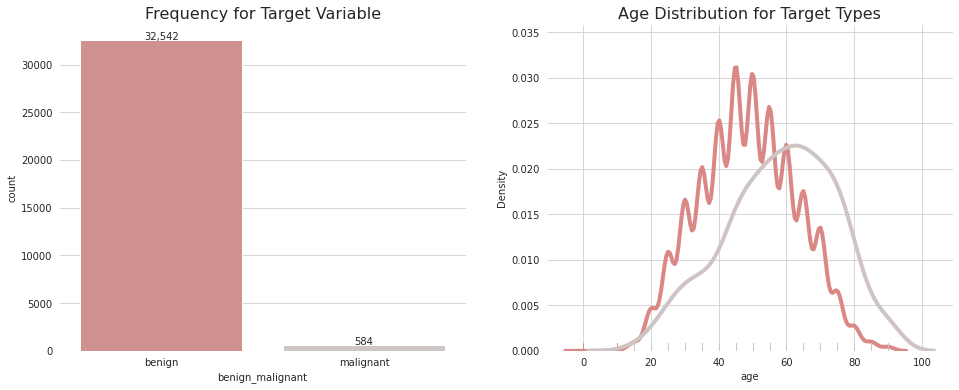

In [ ]:
#figure
f,(ax1,ax2) = plt.subplots(1,2,figsize =(16,6))
a = sns.countplot(data = train_df, x = 'benign_malignant', palette = colors_nude[2:4], ax = ax1)
b = sns.distplot(a = train_df[train_df['target']==0]['age'], ax= ax2, color = colors_nude[2],hist = False,rug = True,kde_kws = dict(linewidth =4), label="Benign")
c = sns.distplot(a = train_df[train_df['target']== 1]['age'], ax= ax2, color = colors_nude[3],hist = False,rug = True,kde_kws = dict(linewidth =4), label="Malignant")

for p in a.patches:
    a.annotate(format(p.get_height(),','),
              (p.get_x() + p.get_width()/2 ,
              p.get_height()), ha = 'center', va = 'center',
              xytext = (0,4), textcoords = 'offset points')


ax1.set_title("Frequency for Target Variable", fontsize = 16)
ax2.set_title("Age Distribution for Target Types", fontsize = 16)

sns.despine(left = True,bottom = True)

# Target and Genders

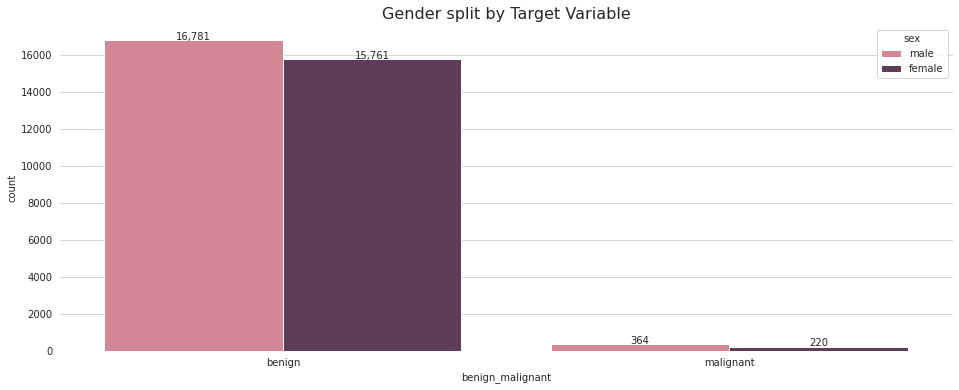

In [ ]:
plt.figure(figsize =(16,6))
a = sns.countplot(data = train_df, x = "benign_malignant",hue = "sex",palette = colors_nude)

for p in a.patches:
    a.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')

plt.title('Gender split by Target Variable', fontsize = 16)
sns.despine(left = True, bottom = True)

# Anatomy and Diagnosis

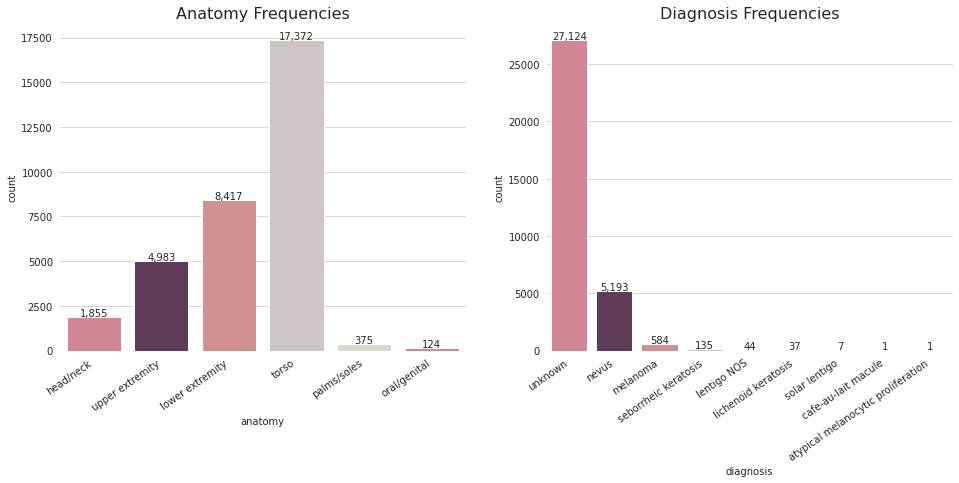

In [ ]:
#figure
f, (ax1,ax2) = plt.subplots(1,2,figsize = (16,6))

a = sns.countplot(train_df['anatomy'], ax = ax1, palette = colors_nude)
b = sns.countplot(train_df['diagnosis'], ax = ax2, palette = colors_nude)

a.set_xticklabels(a.get_xticklabels(), rotation = 35, ha ="right")
b.set_xticklabels(b.get_xticklabels(), rotation = 35, ha = "right")

for p in a.patches:
    a.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')

for p in b.patches:
    b.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')
    
ax1.set_title("Anatomy Frequencies" , fontsize = 16)
ax2.set_title("Diagnosis Frequencies", fontsize = 16)

sns.despine(left = True, bottom = True)

# Anatomy and Target

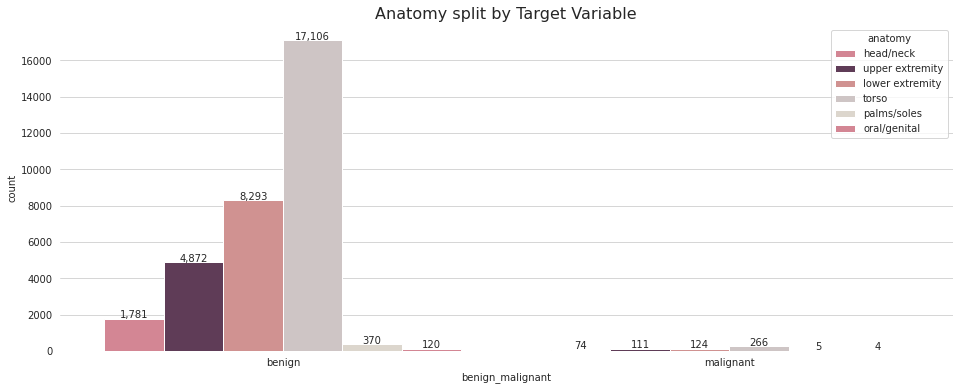

In [ ]:
plt.figure(figsize = (16,6))
a = sns.countplot(data = train_df, x = "benign_malignant", hue = "anatomy", palette = colors_nude)

for p in a.patches:
    a.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')
    
plt.title("Anatomy split by Target Variable", fontsize = 16)
sns.despine(left = True, bottom = True)

# Diagnosis and Target

Text(0.5, 1.0, 'Malignant cases: Diagnosis View')

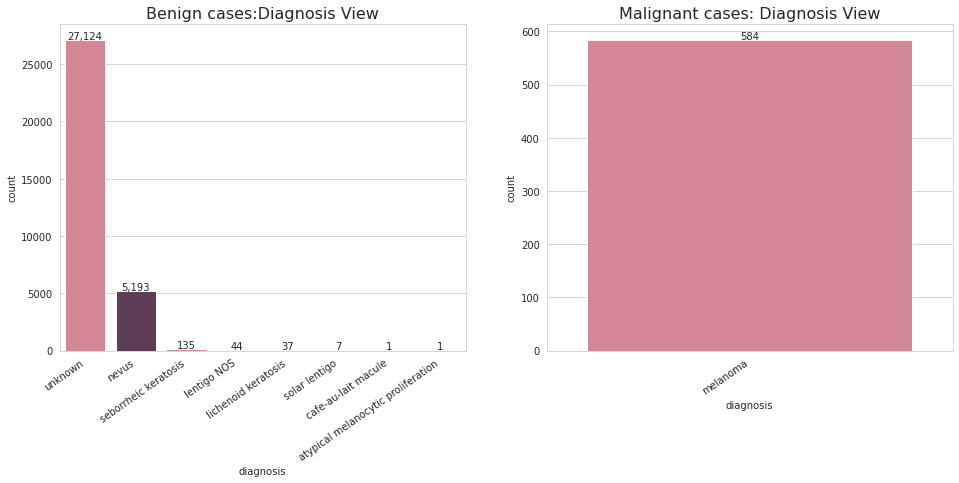

In [ ]:
f, (ax1,ax2)= plt.subplots(1,2,figsize = (16,6))

a = sns.countplot(train_df[train_df['target'] == 0]['diagnosis'], ax = ax1,palette = colors_nude)
b = sns.countplot(train_df[train_df['target']==1]['diagnosis'], ax = ax2, palette = colors_nude)

a.set_xticklabels(a.get_xticklabels(), rotation = 35, ha = "right")
b.set_xticklabels(b.get_xticklabels(), rotation = 35, ha = "right")

for p in a.patches:
    a.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')
    
for p in b.patches:
    b.annotate(format(p.get_height(), ','),
              (p.get_x() + p.get_width()/2,
               p.get_height()), ha = 'center',va = 'center',
               xytext = (0,4), textcoords = 'offset points')

ax1.set_title("Benign cases:Diagnosis View" , fontsize = 16)
ax2.set_title("Malignant cases: Diagnosis View" , fontsize = 16)

# Patients

In [ ]:
#Count the number of images per ID
patients_count_train = train_df.groupby(by ="ID")['dcm_name']

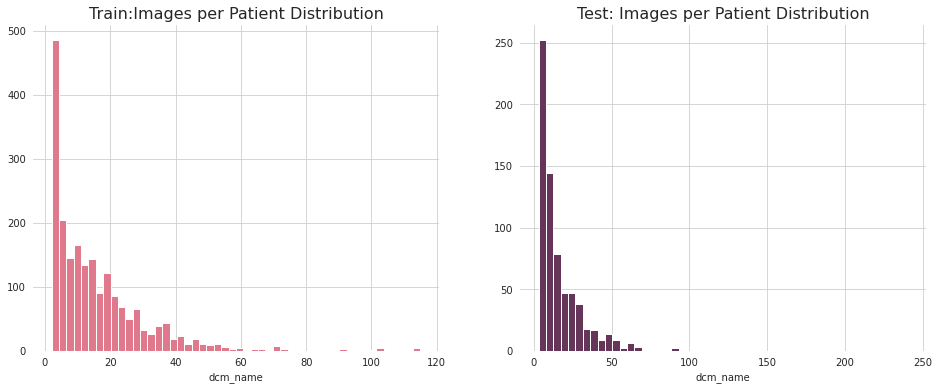

In [ ]:
patients_count_train = train_df.groupby(by ="ID")['dcm_name'].count().reset_index()
patients_count_test = test_df.groupby(by ="ID")['dcm_name'].count().reset_index()

f,(ax1,ax2) = plt.subplots(1,2,figsize =(16,6))

a = sns.distplot( patients_count_train['dcm_name'],kde = False,bins= 50,
                 ax = ax1,color = colors_nude[0],hist_kws = {'alpha':1})

b = sns.distplot(patients_count_test['dcm_name'], kde = False,bins = 50,
                ax = ax2, color = colors_nude[1], hist_kws ={'alpha':1})


ax1.set_title("Train:Images per Patient Distribution", fontsize =16)
ax2.set_title("Test: Images per Patient Distribution", fontsize = 16)
sns.despine(left = True,bottom = True)


In [ ]:
# Save the files again
train_df.to_csv("train_clean.csv", index = False)
test_df.to_csv("test_clean.csv", index = False)

# Preprocess .csv files
# Add Image Path

In [ ]:
# Dicom
# Create the paths
path_train = directory + '/train/'+ train_df['dcm_name'] + '.dcm'
path_test = directory + '/test/' + test_df['dcm_name'] + '.dcm'

# append to the original dataframes
train_df['path_dicom'] = path_train
test_df['path_dicom'] = path_test

#JPEG
#create the paths
path_train = directory + '/jpeg/train/'+ train_df['dcm_name'] + '.jpg'
path_test = directory + '/jpeg/test/' + test_df['dcm_name'] + '.jpg'

#append to the original dataframe
train_df['path_jpeg'] = path_train
test_df['path_jpeg'] = path_test


In [ ]:
train_df_copy = train_df

# One Hot Encoding

In [ ]:
# === TRAIN ===
to_encode = ['sex', 'anatomy', 'diagnosis']
encoded_all = []

label_encoder = LabelEncoder()

for column in to_encode:
    encoded = label_encoder.fit_transform(train_df[column])
    encoded_all.append(encoded)
    
train_df['sex'] = encoded_all[0]
train_df['anatomy'] = encoded_all[1]
train_df['diagnosis'] = encoded_all[2]

if 'benign_malignant' in train_df.columns : train_df.drop(['benign_malignant'], axis=1, inplace=True)

In [ ]:
# Save the files
train_df.to_csv('train_clean.csv', index=False)

In [ ]:
train_df_copy

,dcm_name,ID,sex,age,anatomy,diagnosis,target,path_dicom,path_jpeg
0,ISIC_2637011,IP_7279968,1,45.0,0,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
1,ISIC_0015719,IP_3075186,0,45.0,5,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
2,ISIC_0052212,IP_2842074,0,50.0,1,5,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
3,ISIC_0068279,IP_6890425,0,45.0,0,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
4,ISIC_0074268,IP_8723313,0,55.0,5,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
...,...,...,...,...,...,...,...,...,...
33121,ISIC_9999134,IP_6526534,1,50.0,4,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
33122,ISIC_9999320,IP_3650745,1,65.0,4,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
33123,ISIC_9999515,IP_2026598,1,20.0,1,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
33124,ISIC_9999666,IP_7702038,1,50.0,1,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...


# The Images****

In [ ]:
print('Train .dcm number of images:', len(list(os.listdir('../input/siim-isic-melanoma-classification/train'))), '\n' +
      'Test .dcm number of images:', len(list(os.listdir('../input/siim-isic-melanoma-classification/test'))), '\n' +
      'Train .jpeg number of images:', len(list(os.listdir('../input/siim-isic-melanoma-classification/jpeg/train'))), '\n' +
      'Test .jpeg number of images:', len(list(os.listdir('../input/siim-isic-melanoma-classification/jpeg/test'))), '\n' +
      '-----------------------', '\n' +
      'There is the same number of images as in train/ test .csv datasets')

Train .dcm number of images: 33126 
Test .dcm number of images: 10982 
Train .jpeg number of images: 33126 
Test .jpeg number of images: 10982 
----------------------- 
There is the same number of images as in train/ test .csv datasets


# **Image Shapes**
Also, let's look at the size of the images (to not overload the memory, we'll check 100 different images). They are pretty different,

In [ ]:
shapes_train = []

for k, path in enumerate(train_df['path_jpeg']):
    image = Image.open(path)
    shapes_train.append(image.size)
    
    if k >= 100: break
        
shapes_train = pd.DataFrame(data = shapes_train, columns = ['H', 'W'], dtype='object')
shapes_train['Size'] = '[' + shapes_train['H'].astype(str) + ', ' + shapes_train['W'].astype(str) + ']'

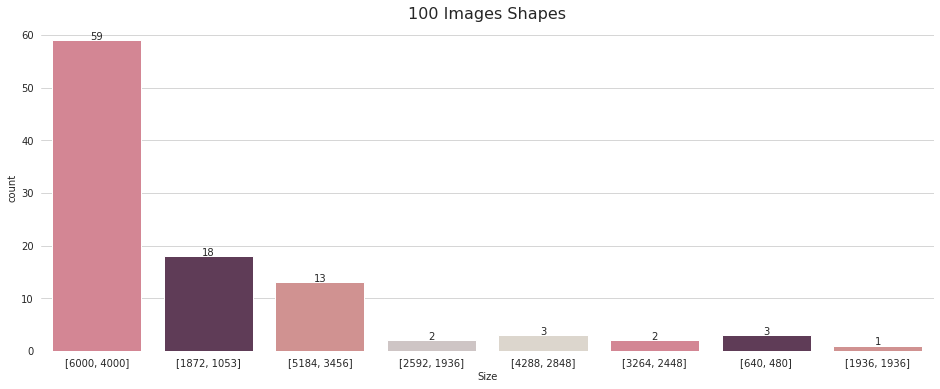

In [ ]:
plt.figure(figsize = (16, 6))

a = sns.countplot(shapes_train['Size'], palette=colors_nude)

for p in a.patches:
    a.annotate(format(p.get_height(), ','), 
           (p.get_x() + p.get_width() / 2., 
            p.get_height()), ha = 'center', va = 'center', 
           xytext = (0, 4), textcoords = 'offset points')
    
plt.title('100 Images Shapes', fontsize=16)
sns.despine(left=True, bottom=True);

# **Dicom Images
# Malignant vs Benign Images**
Let's look at the difference between malignant and benign melanomas.

In [ ]:
def show_images(data, n = 5, rows=1, cols=5, title='Default'):
    plt.figure(figsize=(16,4))

    for k, path in enumerate(data['path_dicom'][:n]):
        image = pydicom.read_file(path)
        image = image.pixel_array
        
        # image = resize(image, (200, 200), anti_aliasing=True)

        plt.suptitle(title, fontsize = 16)
        plt.subplot(rows, cols, k+1)
        plt.imshow(image)
        plt.axis('off')

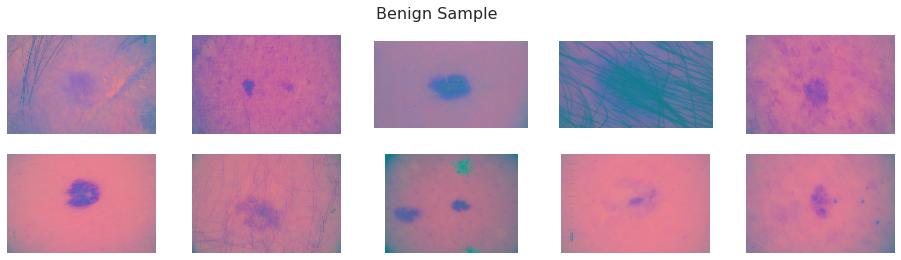

In [ ]:
# Show Benign Samples
show_images(train_df[train_df['target'] == 0], n=10, rows=2, cols=5, title='Benign Sample')

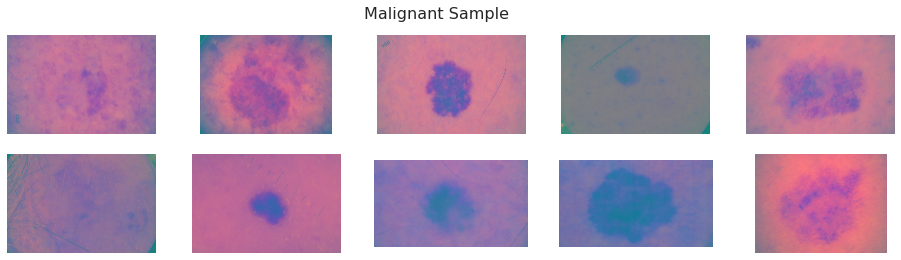

In [ ]:
# Show Malignant Samples
show_images(train_df[train_df['target'] == 1], n=10, rows=2, cols=5, title='Malignant Sample')

# **Black and White View**

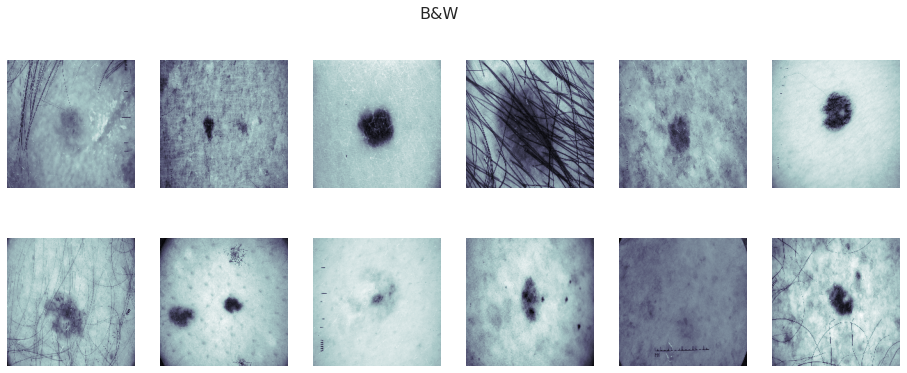

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
plt.suptitle("B&W", fontsize = 16)

for i in range(0, 2*6):
    data = pydicom.read_file(train_df['path_dicom'][i])
    image = data.pixel_array
    
    # Transform to B&W
    # The function converts an input image from one color space to another.
    image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image = cv2.resize(image, (200,200))
    
    x = i // 6
    y = i % 6
    axes[x, y].imshow(image, cmap=plt.cm.bone) 
    axes[x, y].axis('off')

# **Conversion to HSV(Hue,Saturation & Brightness(Value)**

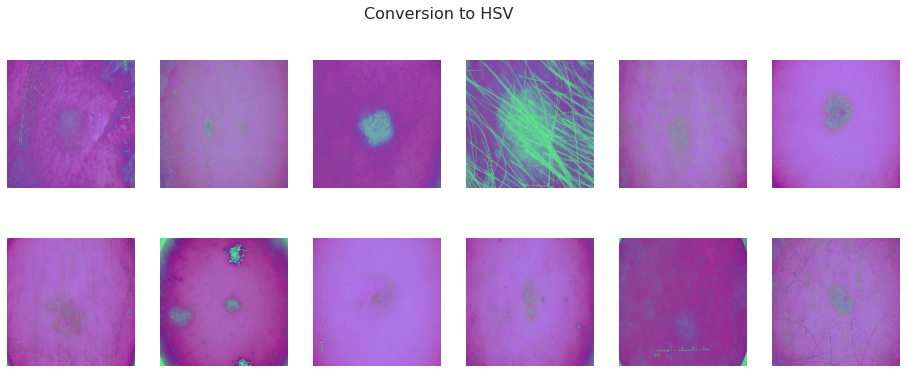

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
plt.suptitle("Conversion to HSV", fontsize = 16)

for i in range(0, 2*6):
    data = pydicom.read_file(train_df['path_dicom'][i])
    image = data.pixel_array
    
    # Transform to B&W
    # The function converts an input image from one color space to another.
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image = cv2.resize(image, (200,200))
    
    x = i // 6
    y = i % 6
    axes[x, y].imshow(image, cmap=plt.cm.bone) 
    axes[x, y].axis('off')

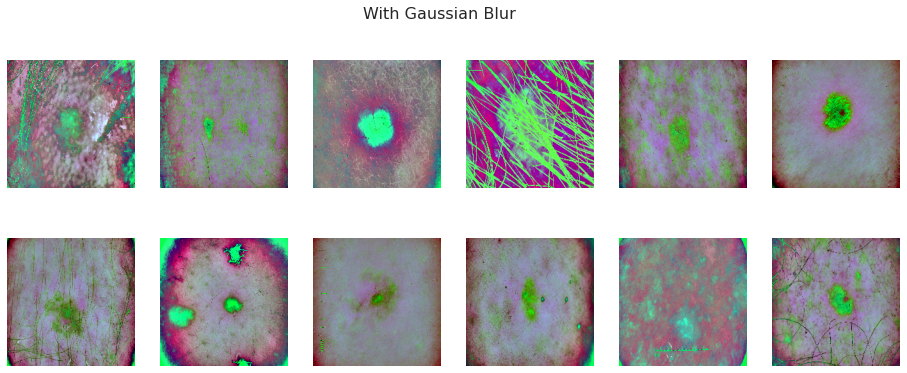

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
plt.suptitle("With Gaussian Blur", fontsize = 16)

for i in range(0, 2*6):
    data = pydicom.read_file(train_df['path_dicom'][i])
    image = data.pixel_array
    
    # Transform to B&W
    # The function converts an input image from one color space to another.
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image = cv2.resize(image, (200,200))
    image=cv2.addWeighted(image, 4, cv2.GaussianBlur(image, (0,0) ,256/10), -4, 128)
    
    x = i // 6
    y = i % 6
    axes[x, y].imshow(image, cmap=plt.cm.bone) 
    axes[x, y].axis('off')

# **Conversion to HLS Space(Hue,lightness,saturation)**

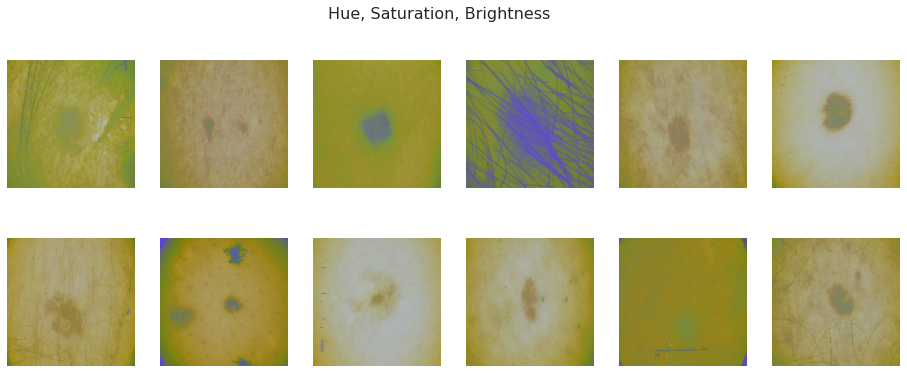

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
plt.suptitle("Hue, Saturation, Brightness", fontsize = 16)

for i in range(0, 2*6):
    data = pydicom.read_file(train_df['path_dicom'][i])
    image = data.pixel_array
    
    # Transform to B&W
    # The function converts an input image from one color space to another.
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    image = cv2.resize(image, (200,200))
    
    x = i // 6
    y = i % 6
    axes[x, y].imshow(image, cmap=plt.cm.bone) 
    axes[x, y].axis('off')

# **LUV Color Space**

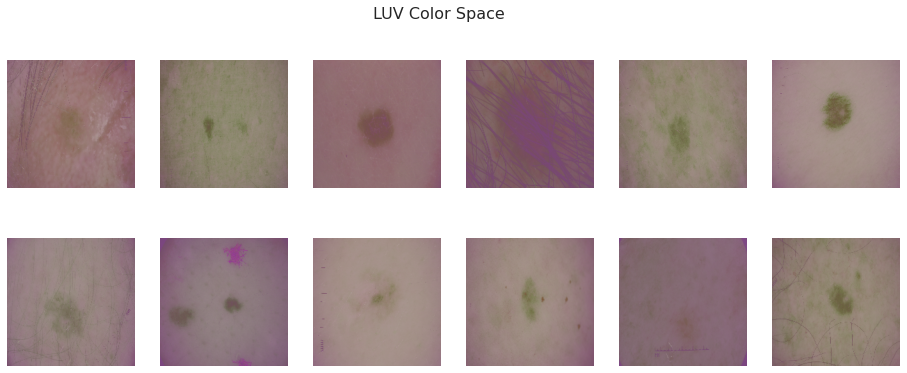

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16,6))
plt.suptitle("LUV Color Space", fontsize = 16)

for i in range(0, 2*6):
    data = pydicom.read_file(train_df['path_dicom'][i])
    image = data.pixel_array
    
    # Transform to B&W
    # The function converts an input image from one color space to another.
    image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    image = cv2.resize(image, (200,200))
    
    x = i // 6
    y = i % 6
    axes[x, y].imshow(image, cmap=plt.cm.bone) 
    axes[x, y].axis('off')

# **Torchvision.transforms**
It's a library that goes hand in hand with **PyTorch** and it's easily used to augment data. 

In [ ]:
#necessary imports 
import torch
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as transforms
import torchvision

17426    ../input/siim-isic-melanoma-classification/jpe...
20839    ../input/siim-isic-melanoma-classification/jpe...
16217    ../input/siim-isic-melanoma-classification/jpe...
1193     ../input/siim-isic-melanoma-classification/jpe...
947      ../input/siim-isic-melanoma-classification/jpe...
9088     ../input/siim-isic-melanoma-classification/jpe...
20484    ../input/siim-isic-melanoma-classification/jpe...
22483    ../input/siim-isic-melanoma-classification/jpe...
9248     ../input/siim-isic-melanoma-classification/jpe...
31801    ../input/siim-isic-melanoma-classification/jpe...
33059    ../input/siim-isic-melanoma-classification/jpe...
8815     ../input/siim-isic-melanoma-classification/jpe...
Name: path_jpeg, dtype: object
0     ../input/siim-isic-melanoma-classification/jpe...
1     ../input/siim-isic-melanoma-classification/jpe...
2     ../input/siim-isic-melanoma-classification/jpe...
3     ../input/siim-isic-melanoma-classification/jpe...
4     ../input/siim-isic-melanoma-cla

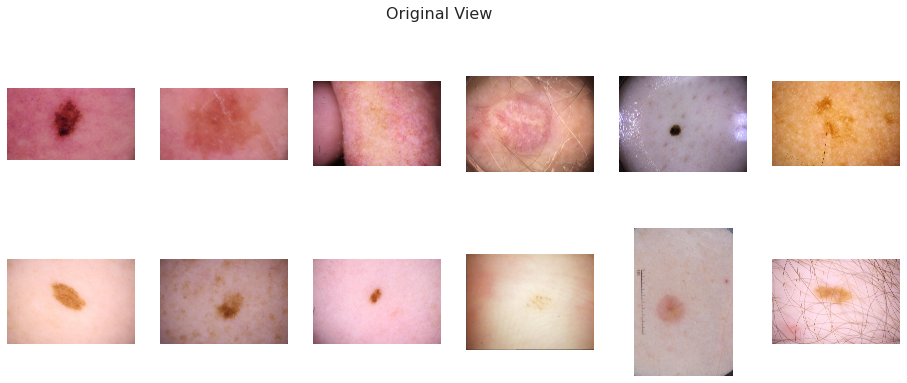

In [ ]:
#select a small sample of the jpeg image paths
image_list = train_df.sample(12)['path_jpeg']
print(image_list)
image_list = image_list.reset_index()['path_jpeg']
print(image_list)

#show the sample
plt.figure(figsize = (16,6))
plt.suptitle("Original View", fontsize = 16)

for k,image_path in enumerate(image_list):
    image = mpimg.imread(image_path)
    
    plt.subplot(2,6,k+1)
    plt.imshow(image)
    plt.axis("off")


In [ ]:
#create Pytorch Dataset object
class DatasetExample(Dataset):
    def __init__(self, image_list, transforms = None):
        self.image_list = image_list
        self.transforms = transforms
        
    def __len__(self):
        return (len(self.image_list))
    
    # for indexing
    def __getitem__(self, i):
        #Read an image
        image = plt.imread(self.image_list[i])
        image = Image.fromarray(image).convert("RGB")
        image = np.asarray(image).astype(np.uint8)
        if self.transforms is not None:
            image = self.transforms(image)
        
        return torch.tensor(image,dtype = torch.float)
    
        

In [ ]:
#predefined show images function

def show_transform(image, title = "Default"):
    plt.figure(figsize = (16,6))
    plt.suptitle(title, fontsize = 16)
    
    #Unnormalize
    image = image/ 2 + 0.5
    npimg = image.numpy()
    npimg = np.clip(npimg,0, 1)
    plt.imshow(np.transpose(npimg,(1,2,0)))
    plt.show()
    

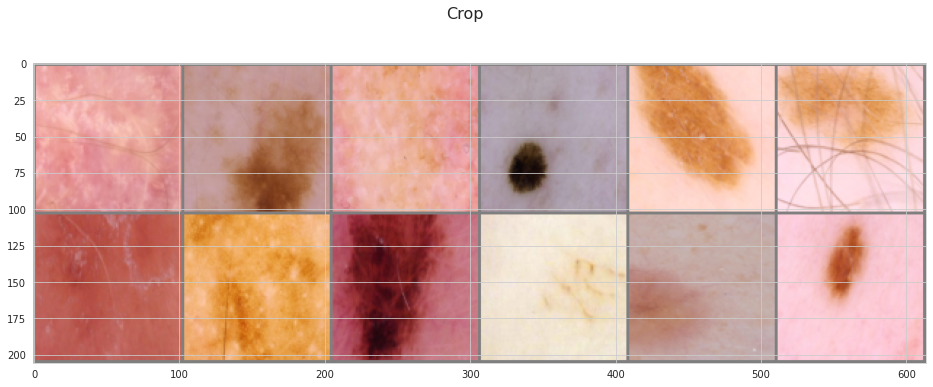

In [ ]:
#Transform
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((300, 300)),
    transforms.CenterCrop((100, 100)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

# Create the dataset
pytorch_dataset = DatasetExample(image_list= image_list, transforms = transform)
pytorch_dataloader = DataLoader(dataset = pytorch_dataset, batch_size =12,shuffle = True)

#select the data
images = next(iter(pytorch_dataloader))

#show images
show_transform(torchvision.utils.make_grid(images, nrow = 6), title = "Crop")


# **ColorJitter**
Randomly change the brightness, contrast and saturation of an image

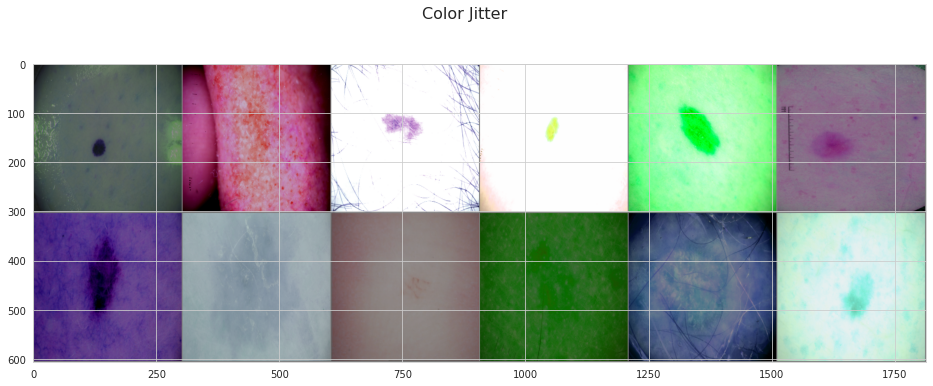

In [ ]:
#Transform
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((300, 300)),
    transforms.ColorJitter(brightness =0.7,contrast = 0.7,saturation =0.7,hue = 0.5),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

# Create the dataset
pytorch_dataset = DatasetExample(image_list= image_list, transforms = transform)
pytorch_dataloader = DataLoader(dataset = pytorch_dataset, batch_size =12,shuffle = True)

#select the data
images = next(iter(pytorch_dataloader))

#show images
show_transform(torchvision.utils.make_grid(images, nrow = 6), title = "Color Jitter")


# **RandomGreyScale**
Randomly convert image to greyscale with a probability of p

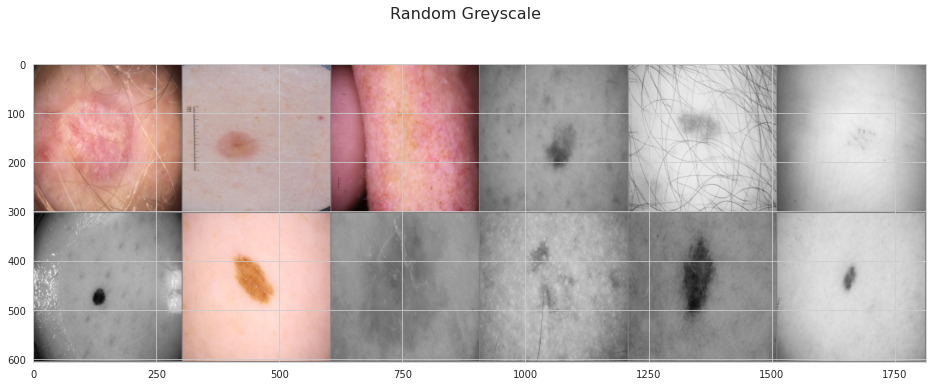

In [ ]:
#Transform
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((300, 300)),
    transforms.RandomGrayscale(p =0.7),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

# Create the dataset
pytorch_dataset = DatasetExample(image_list= image_list, transforms = transform)
pytorch_dataloader = DataLoader(dataset = pytorch_dataset, batch_size =12,shuffle = True)

#select the data
images = next(iter(pytorch_dataloader))

#show images
show_transform(torchvision.utils.make_grid(images, nrow = 6), title = "Random Greyscale")


# **RandomVerticalFlip**
Vertically flip the given PIL Image randomly with a given probability.

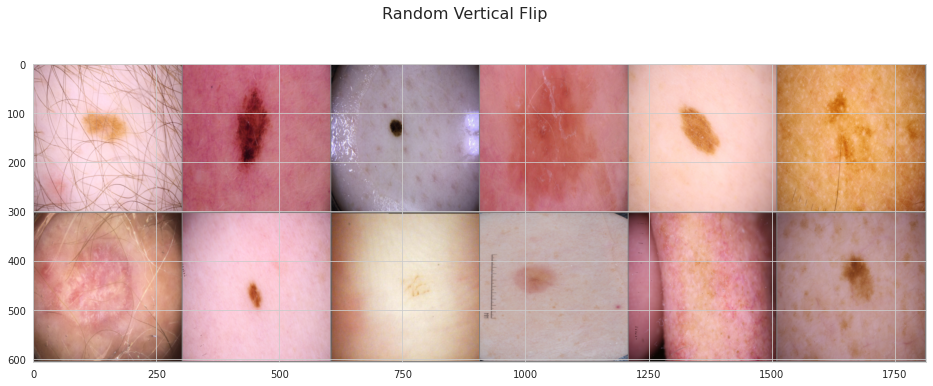

In [ ]:
#Transform
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((300, 300)),
    transforms.RandomVerticalFlip(p =0.7),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

# Create the dataset
pytorch_dataset = DatasetExample(image_list= image_list, transforms = transform)
pytorch_dataloader = DataLoader(dataset = pytorch_dataset, batch_size =12,shuffle = True)

#select the data
images = next(iter(pytorch_dataloader))

#show images
show_transform(torchvision.utils.make_grid(images, nrow = 6), title = "Random Vertical Flip")


# **Hair Removal**
As you may have noticed, all images are for light skin colors, so no preprocessing in this area is required. However, hair removal might be a good augmentation that will help the model perform better.

In [ ]:
BASE_PATH = "../input/siim-isic-melanoma-classification"
hair_images =['ISIC_0078712','ISIC_0080817','ISIC_0082348','ISIC_0109869','ISIC_0155012','ISIC_0159568','ISIC_0164145','ISIC_0194550','ISIC_0194914','ISIC_0202023']
without_hair_images = ['ISIC_0015719','ISIC_0074268','ISIC_0075914','ISIC_0084395','ISIC_0085718','ISIC_0081956']


[]

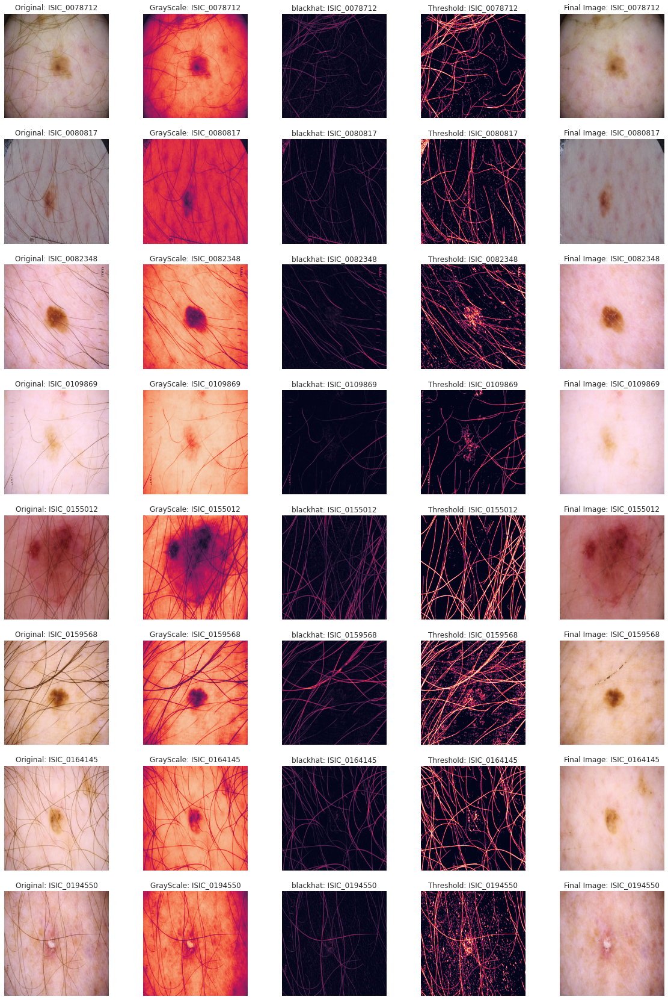

In [ ]:
l = len(hair_images[:8])


fig =plt.figure(figsize = (20,30))


for i,image_name in enumerate(hair_images[:8]):
    image =cv2.imread(BASE_PATH + '/jpeg/train/' + image_name +'.jpg')
    image_resize = cv2.resize(image, (1024,1024))
    plt.subplot(l, 5, (i*5)+1)
    
    #Convert original image to RGB
    plt.imshow(cv2.cvtColor(image_resize, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Original: "+ image_name)
    
    #convert image to grayscale
    grayScale = cv2.cvtColor(image_resize,cv2.COLOR_RGB2GRAY)
    plt.subplot(l,5,(i*5)+2)
    plt.imshow(grayScale)
    plt.axis("off")
    plt.title("GrayScale: " + image_name)
    
    #kernel for morphological filtering
    kernel = cv2.getStructuringElement(1,(17,17))
    
    #perform blackhat filtering on the grayscale image to find hair contours
    blackhat = cv2.morphologyEx(grayScale,cv2.MORPH_BLACKHAT,kernel)
    plt.subplot(l,5, (i*5)+ 3)
    plt.imshow(blackhat)
    plt.axis("off")
    plt.title("blackhat: " + image_name)
    
    
    #intensify the hair contours in preparation for the inpainting
    ret, threshold = cv2.threshold(blackhat, 10,255, cv2.THRESH_BINARY)
    plt.subplot(l,5,(i*5) + 4)
    plt.imshow(threshold)
    plt.axis("off")
    plt.title("Threshold: " + image_name)
    
    #inpaint the original image depending on the mask
    final_image = cv2.inpaint(image_resize,threshold, 1, cv2.INPAINT_TELEA)
    plt.subplot(l,5, (i*5) +5)
    plt.imshow(cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Final Image: " + image_name)
    

plt.plot()


In [ ]:
def hair_remove(image):
    #convert image to greyscale
    grayScale = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    
    #kernel for morphologyEx
    kernel = cv2.getStructuringElement(1,(17,17))
    
    #apply MORPH_Blackhat to grayscale image
    blackhat = cv2.morphologyEx(grayScale,cv2.MORPH_BLACKHAT,kernel)
    #apply thresholding to blackhat
    _, threshold = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY)
    #inpaint with original image and threshold image
    final_image = cv2.inpaint(image,threshold,1,cv2.INPAINT_TELEA)
    
    return final_image
    

In [ ]:
#Select a small sample of the .jpeg image paths
# we select some hairy photos on purpose
hairy_photos = train_df[train_df["sex"]==1].reset_index().iloc[[12, 14,17, 22, 33, 34]]

In [ ]:
hairy_photos

,index,dcm_name,ID,sex,age,anatomy,diagnosis,target,path_dicom,path_jpeg
12,22,ISIC_0082348,IP_7684360,1,55.0,4,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
14,25,ISIC_0083035,IP_5805281,1,50.0,4,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
17,31,ISIC_0085902,IP_3658607,1,45.0,4,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
22,44,ISIC_0091016,IP_4042098,1,40.0,4,5,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
33,68,ISIC_0109568,IP_0825081,1,80.0,1,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...
34,69,ISIC_0109703,IP_8663649,1,45.0,5,8,0,../input/siim-isic-melanoma-classification/tra...,../input/siim-isic-melanoma-classification/jpe...


In [ ]:
image_list = hairy_photos['path_jpeg']
image_list = image_list.reset_index()['path_jpeg']
image_list

0    ../input/siim-isic-melanoma-classification/jpe...
1    ../input/siim-isic-melanoma-classification/jpe...
2    ../input/siim-isic-melanoma-classification/jpe...
3    ../input/siim-isic-melanoma-classification/jpe...
4    ../input/siim-isic-melanoma-classification/jpe...
5    ../input/siim-isic-melanoma-classification/jpe...
Name: path_jpeg, dtype: object

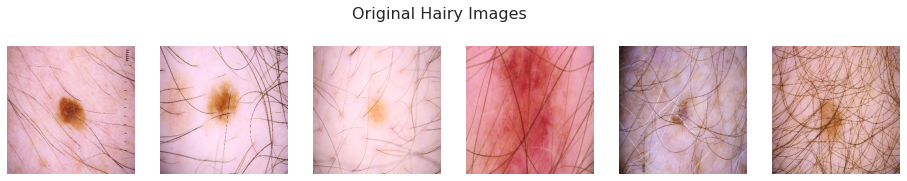

In [ ]:
#show the augmented images
plt.figure(figsize =(16,3))
plt.suptitle("Original Hairy Images" , fontsize = 16)

for k,path in enumerate(image_list):
    image = mpimg.imread(path)
    image = cv2.resize(image, (300,300))
    
    plt.subplot(1,6, k+1)
    plt.imshow(image)
    plt.axis("off")

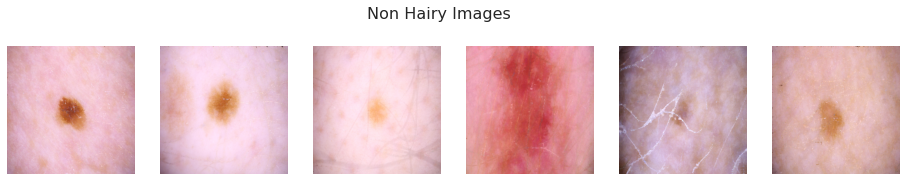

In [ ]:
#show the sample
plt.figure(figsize =(16,3))
plt.suptitle("Non Hairy Images" , fontsize = 16)

for k,path in enumerate(image_list):
    image = mpimg.imread(path)
    image = cv2.resize(image, (300,300))
    image = hair_remove(image)
    
    plt.subplot(1,6, k+1)
    plt.imshow(image)
    plt.axis("off")

# **Diagnosis Visualization**
**We have seven types of diagnosed cancerous growths here:**

* Unkown: a possibly novel type of growth
* Nevus: (from Google) a usually non-cancerous disorder of pigment-producing skin cells commonly called birth marks or moles.
* Melanoma: Skin cancer's form (what we are working with)
* Seborrheic keratosis: Brown, waxy and patchy growths that are not related to skin cancer.
* Lentigo NOS: A type of skin cancer that starts from the outside of the skin and attacks by going inword.
* Lichenoid keratosis: It is a thin pigmented sort of plaque, if you will.
* Solar lentigo: Like lentigo but caused by UV rays from the sun (very common in Delhi)
* cafe-au-lait macule: French for "coffee with milk". These are brownish spots also called "giraffe spots".
* atypical melanocytic proliferation: Abnormal quantities of melanin appear on the skin.

In [ ]:
train_images_dir = "../input/siim-isic-melanoma-classification/train"
def view_images(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,5))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)
    plt.show()    

In [ ]:
train_df_1 = pd.read_csv("../input/siim-isic-melanoma-classification/train.csv")
train_df_1

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
0,ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,benign,0
1,ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,benign,0
2,ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,benign,0
3,ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,benign,0
4,ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,benign,0
...,...,...,...,...,...,...,...,...
33121,ISIC_9999134,IP_6526534,male,50.0,torso,unknown,benign,0
33122,ISIC_9999320,IP_3650745,male,65.0,torso,unknown,benign,0
33123,ISIC_9999515,IP_2026598,male,20.0,lower extremity,unknown,benign,0
33124,ISIC_9999666,IP_7702038,male,50.0,lower extremity,unknown,benign,0


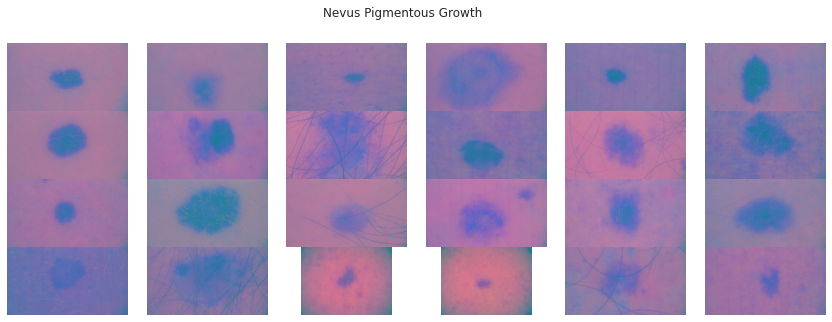

In [ ]:
view_images(train_df_1[train_df_1['diagnosis']=='nevus']['image_name'], title = "Nevus Pigmentous Growth")

From Nevus pigmentatious growth, we can observe that nevus also has an orange halo which is not so visceral and pronounced. This can be confusing as our model can mix up this orange halo and the other orange halo

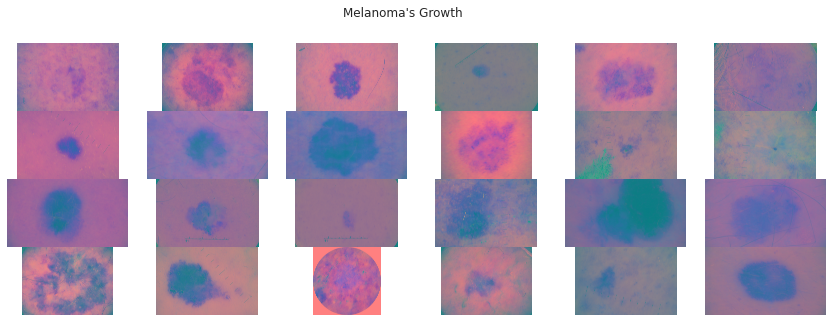

In [ ]:
view_images(train_df_1[train_df_1['diagnosis']=='melanoma']['image_name'], title = "Melanoma's Growth")

Now that is cancer. Melanoma in most cases displays the vicious and visceral orange halo as it devours alive other poor cells who where unlucky enough to cross its path.

In [ ]:
train_df_1.diagnosis.value_counts()

unknown                               27124
nevus                                  5193
melanoma                                584
seborrheic keratosis                    135
lentigo NOS                              44
lichenoid keratosis                      37
solar lentigo                             7
cafe-au-lait macule                       1
atypical melanocytic proliferation        1
Name: diagnosis, dtype: int64

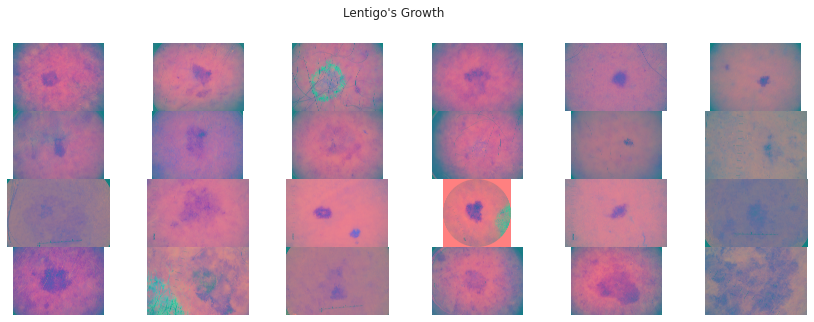

In [ ]:
view_images(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")

Lentigo has not only the orange halo of death but also the green halo, which could be what distinguishes lentigo from melanoma. This green halo could be a special characteristic of lentigo that could help our model to distinguish lentigo from other carcinogenic growths.

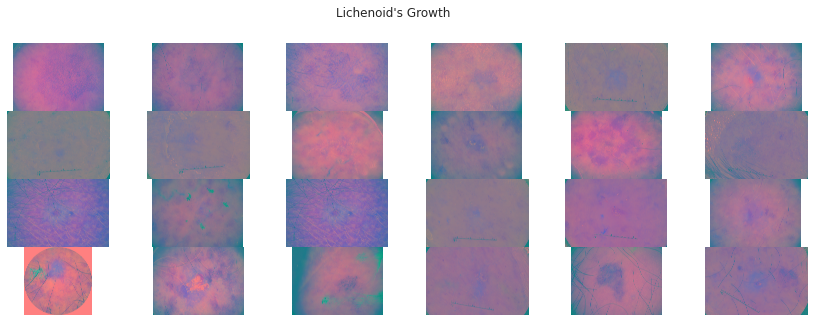

In [ ]:
view_images(train_df_1[train_df_1['diagnosis']=='lichenoid keratosis']['image_name'], title = "Lichenoid's Growth")

Lichenoid mimics the dangers of real carcinogenous growth with its halo(s). Lichenoid is very good at mimicking other forms of cancer.

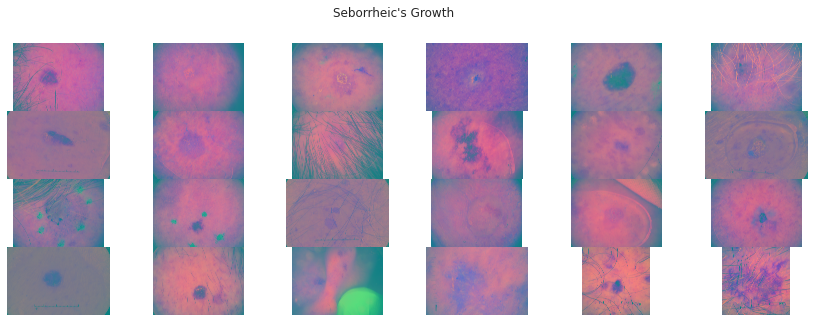

In [ ]:
view_images(train_df_1[train_df_1['diagnosis']=='seborrheic keratosis']['image_name'], title = "Seborrheic's Growth")

Seborrheic and lichenoid keratosis are both rather similar.

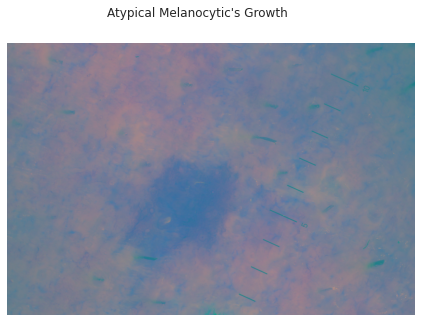

In [ ]:
def view_one_image(images, title ="", aug = None):
    width = 1
    height = 1
    fig,axs = plt.subplots(height, width, figsize =(15,5))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        axs.imshow(image,cmap = plt.cm.bone)
        axs.axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)
    plt.show() 
    
view_one_image(train_df_1[train_df_1['diagnosis']=='atypical melanocytic proliferation']['image_name'], title = "Atypical Melanocytic's Growth")

# Convert to **LAB Colorspace** and **CLAHE** applied on a single channel

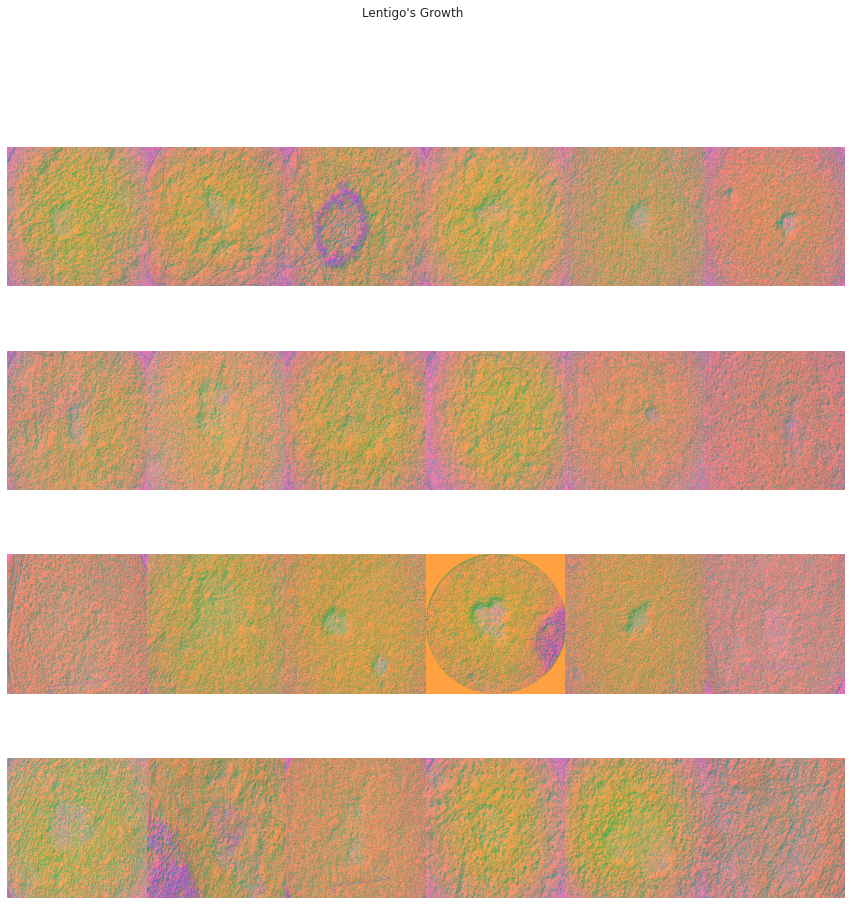

In [ ]:
def view_images_aug(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,15))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        image = cv2.resize(image, (256,256))
        clahe = cv2.createCLAHE(clipLimit =2.0 , tileGridSize = (256,256))
        image[:,:,0] = clahe.apply(image[:,:,0])
        
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)


view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")

# **Grayscale Images**
We will first try to visualize in grayscale (only gray colors) so that it is possible for us to clearly visualize the varied differences in color, region, and shape.

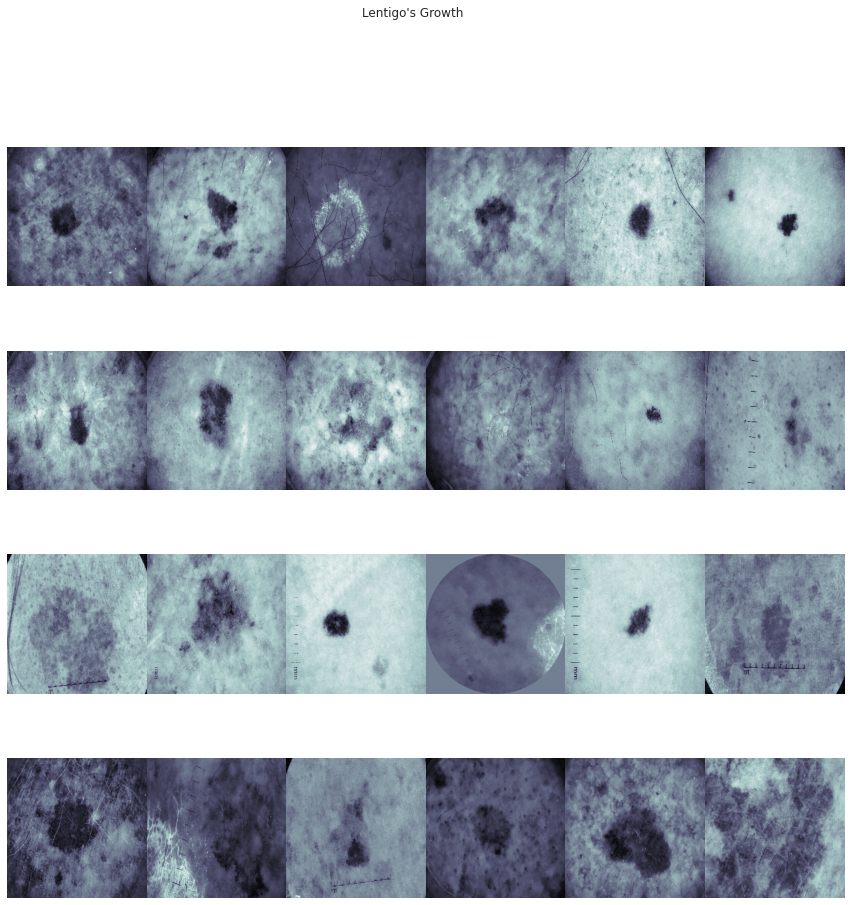

In [ ]:
def view_images_aug(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,15))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = cv2.resize(image, (256,256))        
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)


view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")

# **Neuron Engineer's Method**

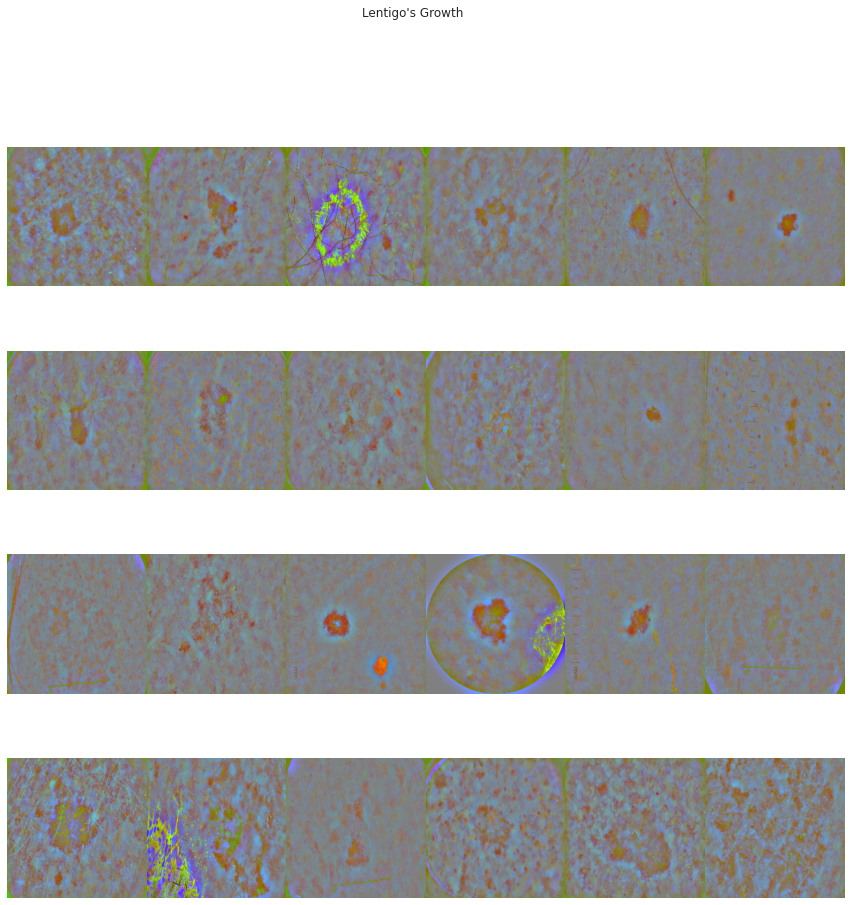

In [ ]:
def view_images_aug(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,15))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #conversion from BGR image to RGB channel image
        image = cv2.resize(image, (256,256)) 
        image= cv2.addWeighted ( image,4, cv2.GaussianBlur( image , (0,0) , 10) ,-4 ,128) #adding Gaussian Blur to the images

        
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)
    
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")

# **Circle Crop**

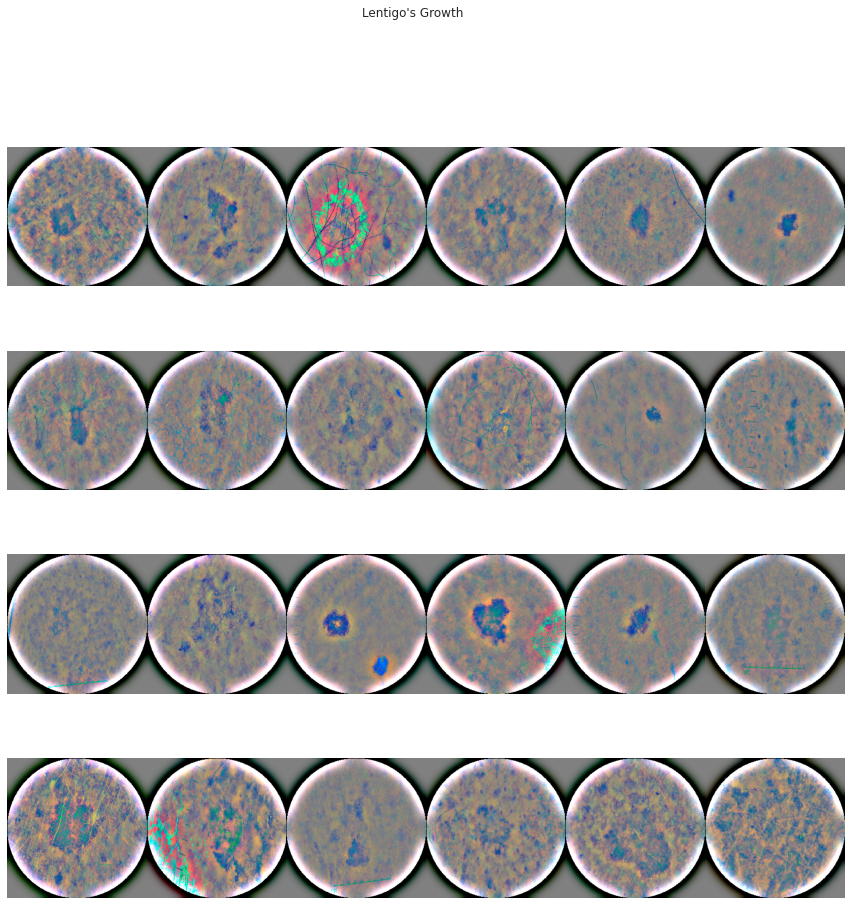

In [ ]:
def crop_image_from_gray(img, tol =7):
    if img.ndim == 2:
        mask = img > tol
        return img[np.ix_(mask.any(1), mask.any(0))]
    elif img.ndim == 3:
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        mask = gray_img > tol
        
        check_shape = img[:,:,0][np.ix_(mask.any(1), mask.any(0))].shape[0]
        if (check_shape == 0): #image is too dark that we crop out everything
            return img # return original image
        else:
            img1 = img[:,:,0][np.ix_(mask.any(1), mask.any(0))]
            img2 = img[:,:,1][np.ix_(mask.any(1), mask.any(0))]
            img3 = img[:,:,2][np.ix_(mask.any(1), mask.any(0))]
            img = np.stack([img1,img2,img3], axis = -1)
    return img
    
def circle_crop(img, sigmaX = 10):
    "Create circular crop around image centre"
    img = crop_image_from_gray(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    height,width,depth = img.shape
    
    x = int(width/2)
    y = int(height/2)
    r = np.amin((x,y))
    
    circle_img = np.zeros((height,width), np.uint8)
    cv2.circle(circle_img,(x,y), int(r), 1, thickness = -1)
    img = cv2.bitwise_and(img,img, mask = circle_img)
    img = crop_image_from_gray(img)
    
    img = cv2.addWeighted(img, 4,cv2.GaussianBlur(img,(0,0),sigmaX) , -4, 128)
    
    return img

def view_images_aug(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,15))
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #conversion from BGR image to RGB channel image
        image = cv2.resize(image, (256,256)) 
        image = circle_crop(image)

        
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)
    
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")   

Circular crop has successfully worked, although it may not be feasible for images where the tumor is on the edge of the image.

# **Auto Cropping**

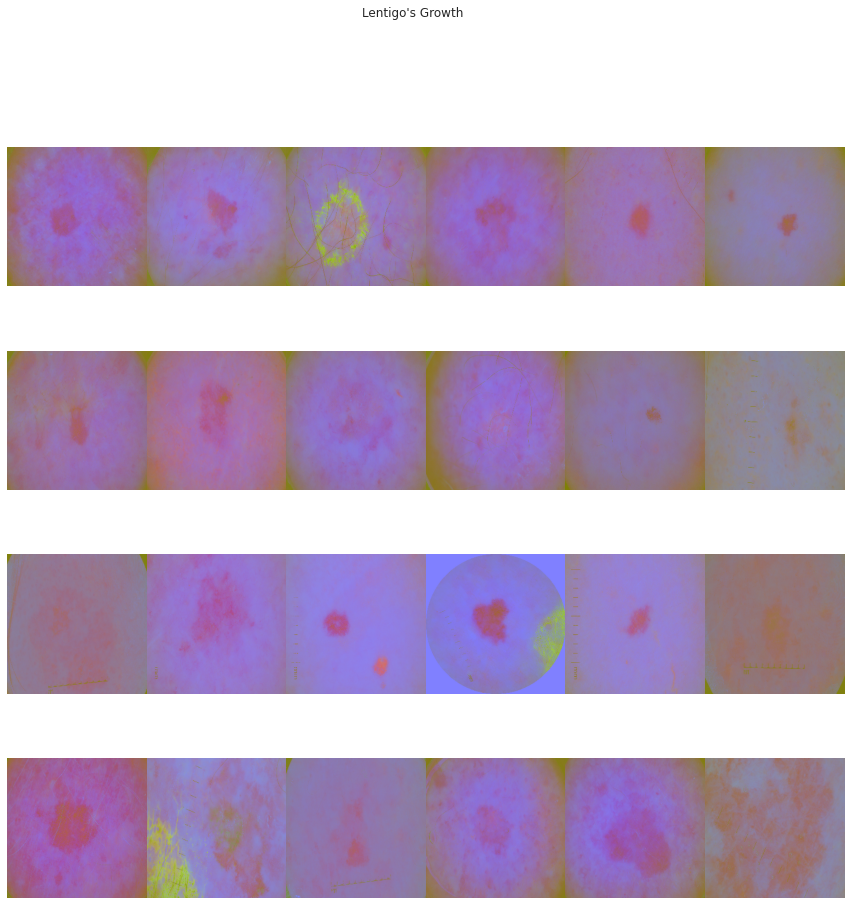

In [ ]:
def crop_image_from_gray(img, tol =7):
    if img.ndim == 2:
        mask = img > tol
        return img[np.ix_(mask.any(1), mask.any(0))]
    elif img.ndim == 3:
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        mask = gray_img > tol
        
        check_shape = img[:,:,0][np.ix_(mask.any(1), mask.any(0))].shape[0]
        if (check_shape == 0): #image is too dark that we crop out everything
            return img # return original image
        else:
            img1 = img[:,:,0][np.ix_(mask.any(1), mask.any(0))]
            img2 = img[:,:,1][np.ix_(mask.any(1), mask.any(0))]
            img3 = img[:,:,2][np.ix_(mask.any(1), mask.any(0))]
            img = np.stack([img1,img2,img3], axis = -1)
    return img

def view_images_aug(images, title ="", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height, width, figsize =(15,15), constrained_layout=True)
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir,list(images)[im] + '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #conversion from BGR image to RGB channel image
        image = cv2.resize(image, (256,256)) 
        image = crop_image_from_gray(image)

        
        i = im // width
        j = im % width
        axs[i,j].imshow(image,cmap = plt.cm.bone)
        axs[i,j].axis('off')
    
    plt.subplots_adjust(wspace =0,hspace =0)
    plt.suptitle(title)
    
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title = "Lentigo's Growth")   

# **Background Subtraction**
Another thing you can do is Background Subtraction.

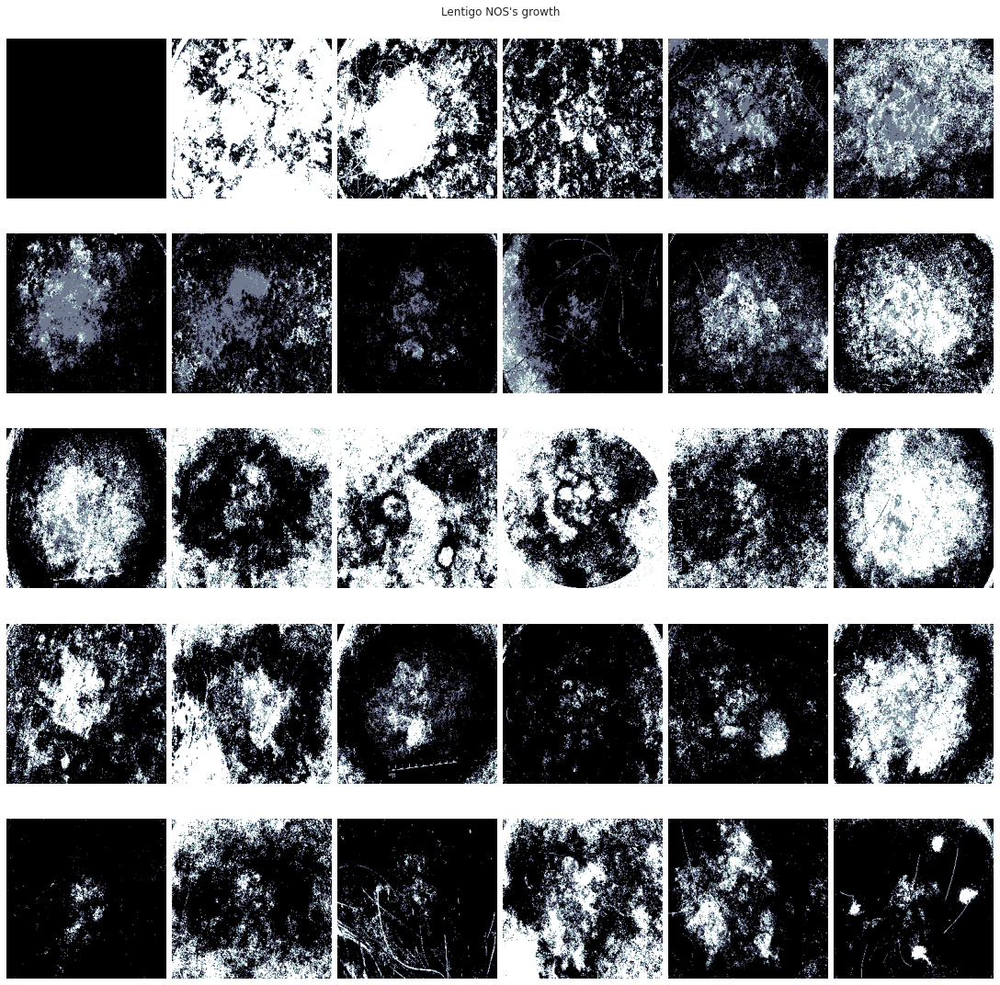

In [ ]:
fgbg = cv2.createBackgroundSubtractorMOG2()
def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 5
    fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout=True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        image= fgbg.apply(image)
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
        
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

# **Image Segmentation**

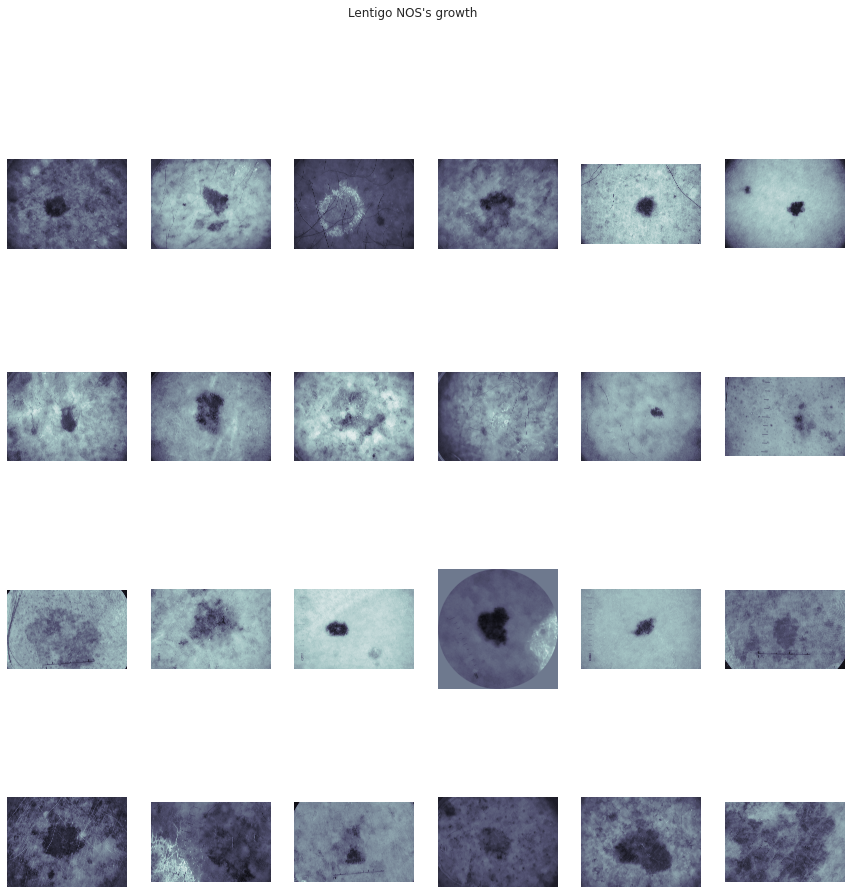

In [ ]:
def view_images_aug(images, title = "", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height,width,figsize =(15,15))
    
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        ret, threshold = cv2.threshold(image,0,255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)

view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");
        

This is called **image segmentation.** It breals down an image into its constituent parts represented by the distinction between regions (i.e **in this instance the growth is white and the halo/surrrounding area is blackened)**. It helps our model to visually understand the distinctions even better than using grayscale images and it also helps to let our model identify the tumor.

However, it has a heavy downside as we lose all information inside and outside the growth and thus our model loses the capability to understand or learn something from the image.

# **A finer method for image segmentation**

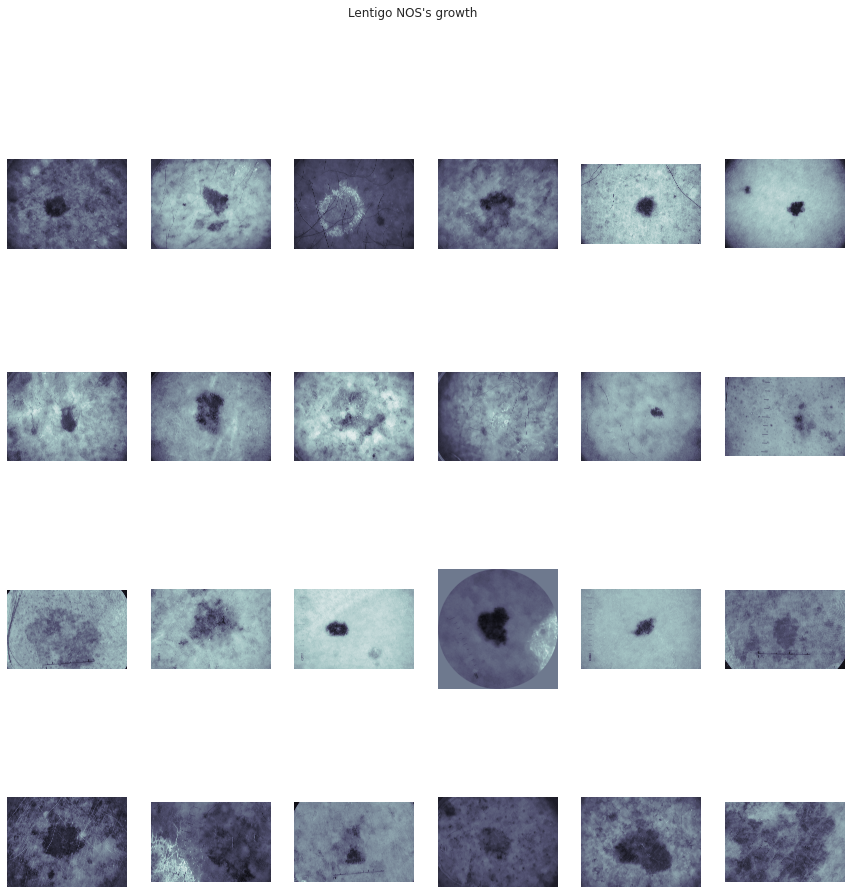

In [ ]:
def view_images_aug(images, title = "", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height,width,figsize =(15,15))
    
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        ret, threshold = cv2.threshold(image,0,255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        kernel = np.ones((3,3), np.uint8)
        opening = cv2.morphologyEx(threshold,cv2.MORPH_OPEN,kernel, iterations = 2)
        
        #sure background area
        sure_bg = cv2.dilate(opening, kernel, iterations = 3)
        
        #Finding sure foreground area
        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2, 5)
        ret, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)
        
        #finding unknown area
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract( sure_bg, sure_fg)
        
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");


# **Grayscale Image Segmentation**
# Watershed Algorithm**

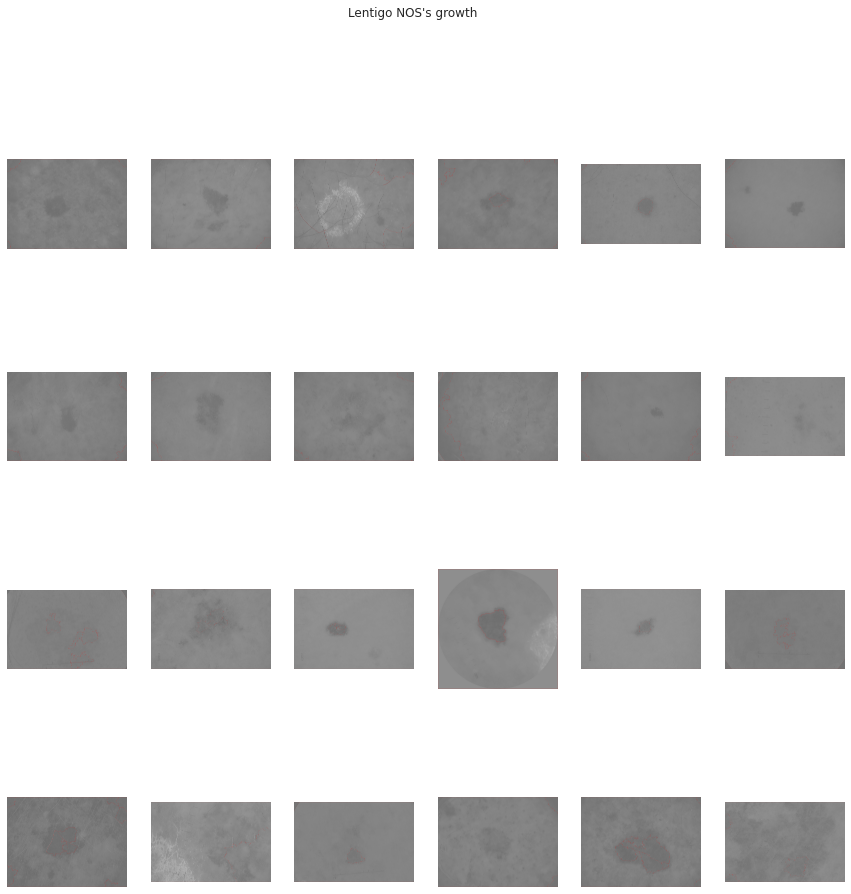

In [ ]:
def view_images_aug(images, title = "", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height,width,figsize =(15,15))
    
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        ret, threshold = cv2.threshold(image,0,255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
        kernel = np.ones((3,3), np.uint8)
        opening = cv2.morphologyEx(threshold,cv2.MORPH_OPEN,kernel, iterations = 2)
        
        #sure background area
        sure_bg = cv2.dilate(opening, kernel, iterations = 3)
        
        #Finding sure foreground area
        dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2, 5)
        ret, sure_fg = cv2.threshold(dist_transform, 0.7*dist_transform.max(), 255, 0)
        
        #finding unknown area
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract( sure_bg, sure_fg)
        ret, markers = cv2.connectedComponents(sure_fg)
        
        # Add one to all labels so that sure background is not 0, but 1
        markers = markers + 1
        
        markers[unknown == 255] =0
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
        
        markers = cv2.watershed(image, markers)
        image[markers == -1] = [255,0,0]
        
        
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)

view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

These are now the segmented grayscale images, complete with markers. It will be a bit difficult for the model to learn anything from this due to the complete and utter confusion (pardon me) in the image with regard to the clear distinctions between image segments and there is no disctinction between parts of the image

# **Fourier Method for Pixel Distribution**

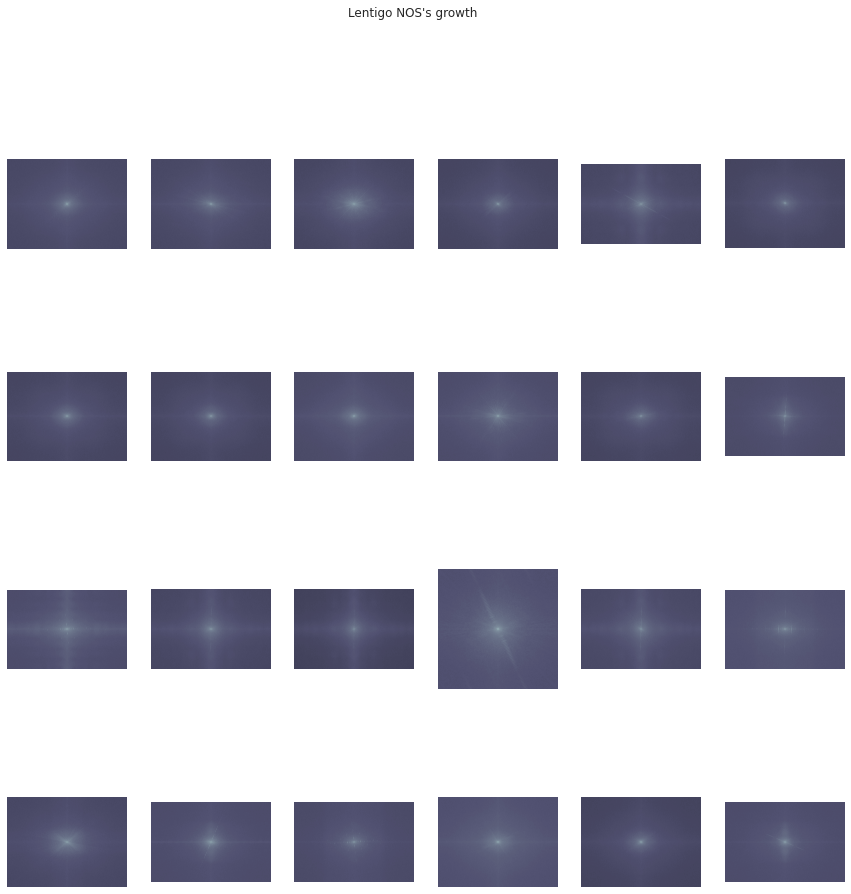

In [ ]:
from numpy.fft import *

def view_images_aug(images, title = "", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height,width,figsize =(15,15))
    
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        f = np.fft.fft2(image)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = 20*np.log(np.abs(fshift))
        
        
        i = im // width
        j = im % width
        axs[i,j].imshow(magnitude_spectrum, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)

view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

It is helpful to understand where the majority of the growth is concentrated.

# **Albumentations library demonstration**

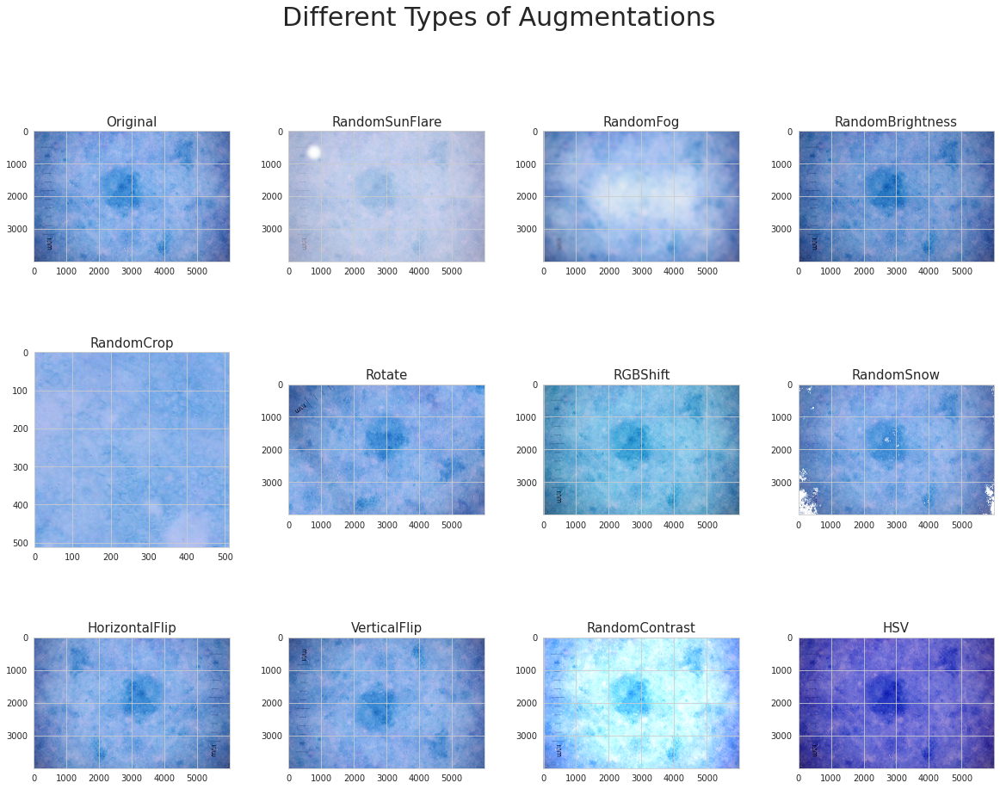

In [ ]:
import albumentations as A
image_folder_path = "../input/siim-isic-melanoma-classification/jpeg/train"
chosen_image = cv2.imread(os.path.join(image_folder_path, "ISIC_0079038.jpg"))
albumentation_list = [A.RandomSunFlare(p =1),A.RandomFog(p=1),A.RandomBrightness(p=1),
                     A.RandomCrop(p=1,height=512,width=512),A.Rotate(p=1,limit =90),
                     A.RGBShift(p=1),A.RandomSnow(p =1),
                     A.HorizontalFlip(p=1),A.VerticalFlip(p=1),A.RandomContrast(limit =0.5, p=1),
                     A.HueSaturationValue(p=1,hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=50)]

img_matrix_list =[]
bboxes_list =[]

for aug_type in albumentation_list:
    img = aug_type(image = chosen_image)['image']
    img_matrix_list.append(img)

img_matrix_list.insert(0, chosen_image)

titles_list = ["Original","RandomSunFlare","RandomFog","RandomBrightness",
               "RandomCrop","Rotate", "RGBShift", "RandomSnow","HorizontalFlip", 
               "VerticalFlip", "RandomContrast","HSV"]


#helper function
def plot_multiple_img(img_matrix_list,title_list, ncols, main_title =""):
    fig,myaxes = plt.subplots(figsize =(20,15),nrows = 3, ncols = ncols ,squeeze = False)
    fig.suptitle(main_title,fontsize = 30)
    fig.subplots_adjust(wspace = 0.3)
    fig.subplots_adjust(hspace = 0.3)
    
    for i, (img, title) in enumerate(zip(img_matrix_list,title_list)):
        myaxes[i // ncols][i % ncols].imshow(img)
        myaxes[i // ncols][i % ncols].set_title(title, fontsize = 15)
        
    plt.show()

plot_multiple_img(img_matrix_list,titles_list, ncols =4, main_title ="Different Types of Augmentations")

We have much more augmentations we can try like:

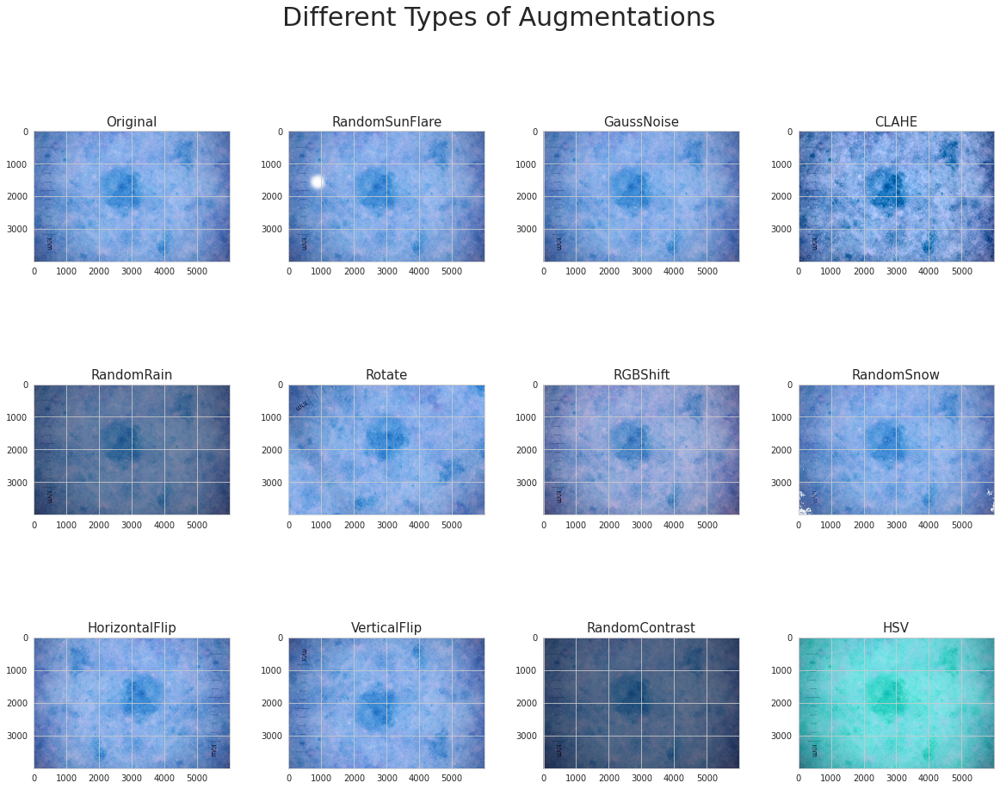

In [ ]:
image_folder_path = "../input/siim-isic-melanoma-classification/jpeg/train"
chosen_image = cv2.imread(os.path.join(image_folder_path, "ISIC_0079038.jpg"))
albumentation_list = [A.RandomSunFlare(p =1),A.GaussNoise(p=1),A.CLAHE(p=1),
                     A.RandomRain(p=1),A.Rotate(p=1,limit =90),
                     A.RGBShift(p=1),A.RandomSnow(p =1),
                     A.HorizontalFlip(p=1),A.VerticalFlip(p=1),A.RandomContrast(limit =0.5, p=1),
                     A.HueSaturationValue(p=1,hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=50)]

img_matrix_list =[]
bboxes_list =[]

for aug_type in albumentation_list:
    img = aug_type(image = chosen_image)['image']
    img_matrix_list.append(img)

img_matrix_list.insert(0, chosen_image)

titles_list = ["Original","RandomSunFlare","GaussNoise","CLAHE",
               "RandomRain","Rotate", "RGBShift", "RandomSnow",
               "HorizontalFlip", "VerticalFlip", "RandomContrast","HSV"]


#helper function
def plot_multiple_img(img_matrix_list,title_list, ncols, main_title =""):
    fig,myaxes = plt.subplots(figsize =(20,15),nrows = 3, ncols = ncols ,squeeze = False)
    fig.suptitle(main_title,fontsize = 30)
    fig.subplots_adjust(wspace = 0.3)
    fig.subplots_adjust(hspace = 0.3)
    
    for i, (img, title) in enumerate(zip(img_matrix_list,title_list)):
        myaxes[i // ncols][i % ncols].imshow(img)
        myaxes[i // ncols][i % ncols].set_title(title, fontsize = 15)
        
    plt.show()

plot_multiple_img(img_matrix_list,titles_list, ncols =4, main_title ="Different Types of Augmentations")

# **Mess Around With p**

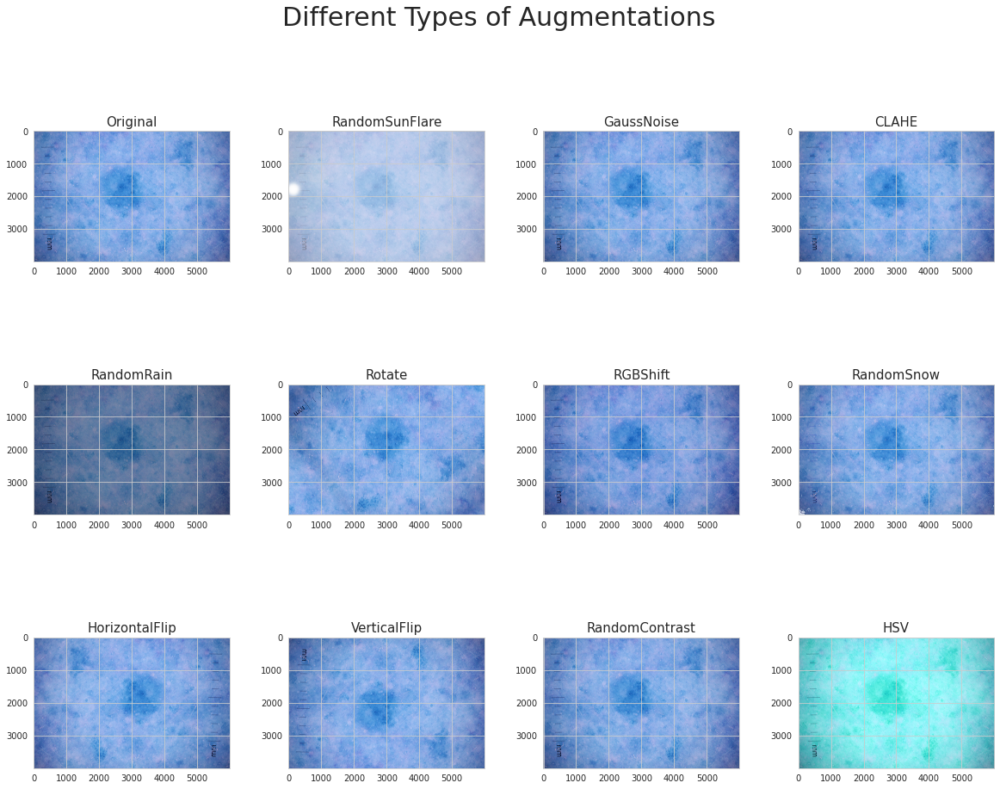

In [ ]:
image_folder_path = "../input/siim-isic-melanoma-classification/jpeg/train"
chosen_image = cv2.imread(os.path.join(image_folder_path, "ISIC_0079038.jpg"))
albumentation_list = [A.RandomSunFlare(p =0.8),A.GaussNoise(p= 0.8),A.CLAHE(p= 0.9),
                     A.RandomRain(p=1),A.Rotate(p=1,limit =90),
                     A.RGBShift(p=1),A.RandomSnow(p =1),
                     A.HorizontalFlip(p= 0.8),A.VerticalFlip(p= 0.8),A.RandomContrast(limit =0.5, p=1),
                     A.HueSaturationValue(p=1,hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=50)]

img_matrix_list =[]
bboxes_list =[]

for aug_type in albumentation_list:
    img = aug_type(image = chosen_image)['image']
    img_matrix_list.append(img)

img_matrix_list.insert(0, chosen_image)

titles_list = ["Original","RandomSunFlare","GaussNoise","CLAHE",
               "RandomRain","Rotate", "RGBShift", "RandomSnow",
               "HorizontalFlip", "VerticalFlip", "RandomContrast","HSV"]


#helper function
def plot_multiple_img(img_matrix_list,title_list, ncols, main_title =""):
    fig,myaxes = plt.subplots(figsize =(20,15),nrows = 3, ncols = ncols ,squeeze = False)
    fig.suptitle(main_title,fontsize = 30)
    fig.subplots_adjust(wspace = 0.3)
    fig.subplots_adjust(hspace = 0.3)
    
    for i, (img, title) in enumerate(zip(img_matrix_list,title_list)):
        myaxes[i // ncols][i % ncols].imshow(img)
        myaxes[i // ncols][i % ncols].set_title(title, fontsize = 15)
        
    plt.show()

plot_multiple_img(img_matrix_list,titles_list, ncols =4, main_title ="Different Types of Augmentations")

# **Erosion**

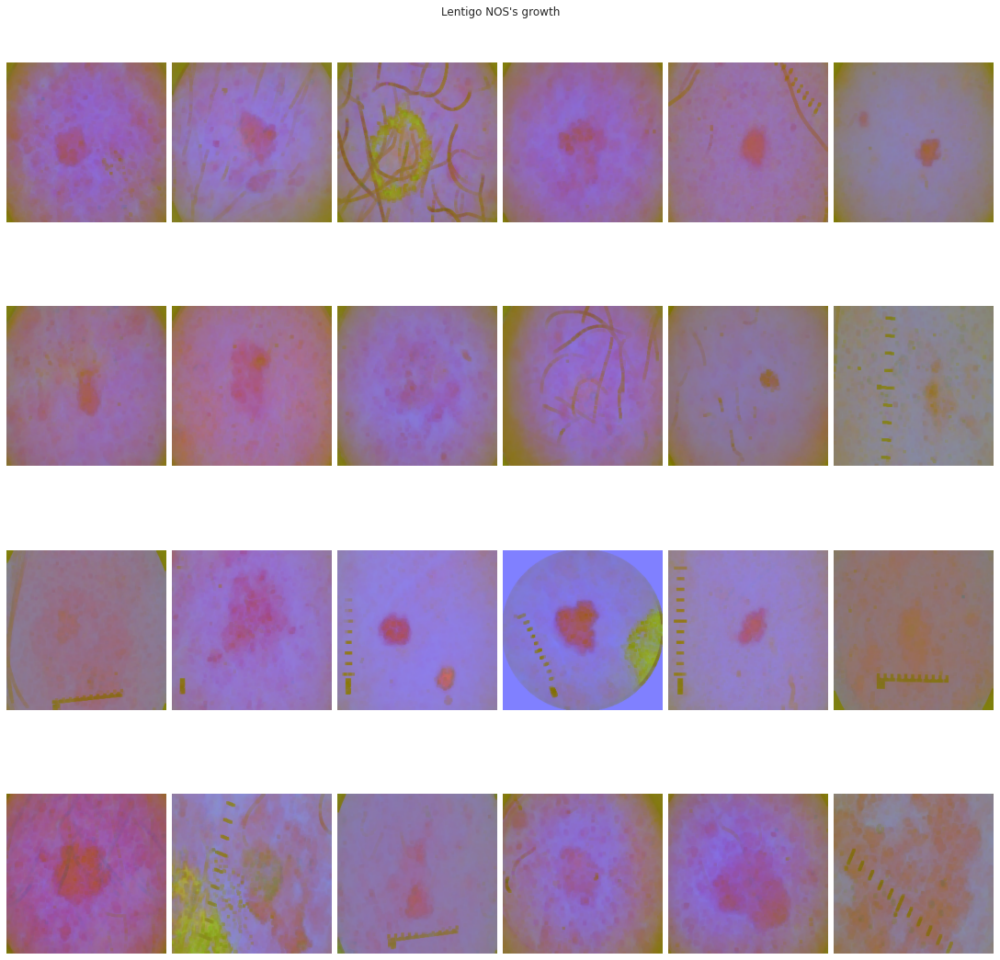

In [ ]:
def view_images_aug(images, title = "", aug = None):
    width = 6
    height = 4
    fig,axs = plt.subplots(height,width,figsize =(15,15),constrained_layout=True)
    
    for im in range(0, height*width):
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm')) 
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        
        kernel = np.ones((5,5), np.uint8)
        
        # The first parameter is the original image, 
        # kernel is the matrix with which image is  
        # convolved and third parameter is the number  
        # of iterations, which will determine how much  
        # you want to erode/dilate a given image.  
        img_erosion = cv2.erode(image, kernel, iterations=1) 
        
        i = im // width
        j = im % width
        axs[i,j].imshow(img_erosion, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)

view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

# **Dilation**
There! Now we can try dilation.

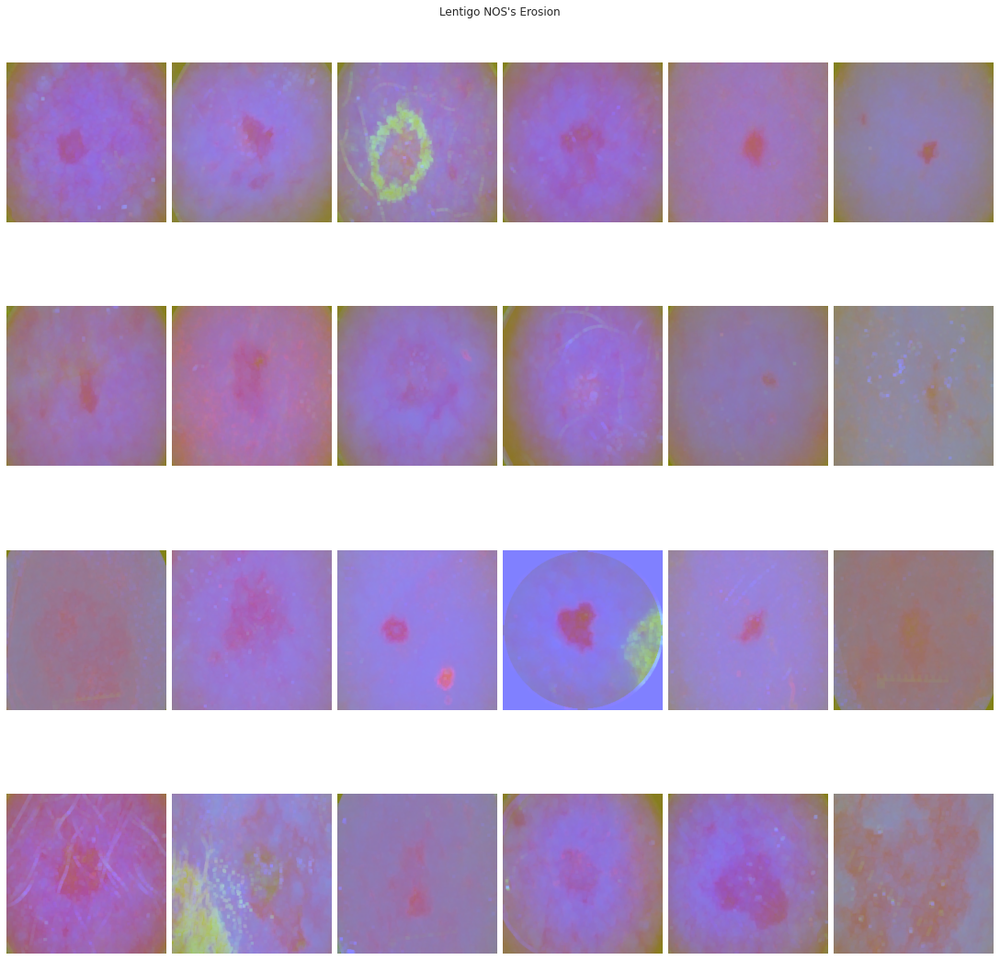

In [ ]:
def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 4
    fig, axs = plt.subplots(height, width, figsize=(15,15),constrained_layout = True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        kernel = np.ones((5,5), np.uint8) 
        
        #dilation is performed here.
        img_dilation = cv2.dilate(image, kernel, iterations=1) 
        i = im // width
        j = im % width
        axs[i,j].imshow(img_dilation, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
        
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's Erosion");

# **Combination of Erosion and Dilation**

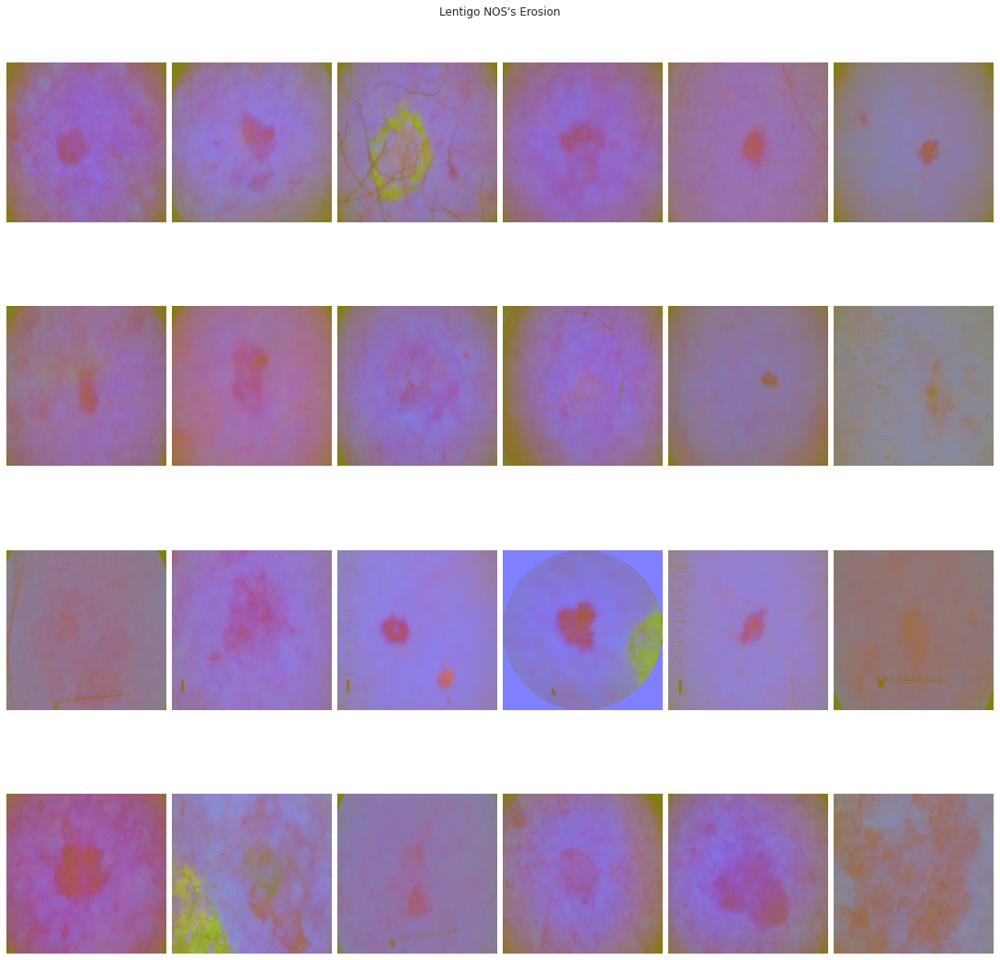

In [ ]:
def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 4
    fig, axs = plt.subplots(height, width, figsize=(15,15),constrained_layout = True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        kernel = np.ones((5,5), np.uint8) 
        #   
        img_erosion = cv2.erode(image, kernel, iterations=1) 
        img_dilation = cv2.dilate(img_erosion, kernel, iterations=1) 
        i = im // width
        j = im % width
        axs[i,j].imshow(img_dilation, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
        
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's Erosion");

# **Complex Wavelet Transform**
**Horizontal Detail**

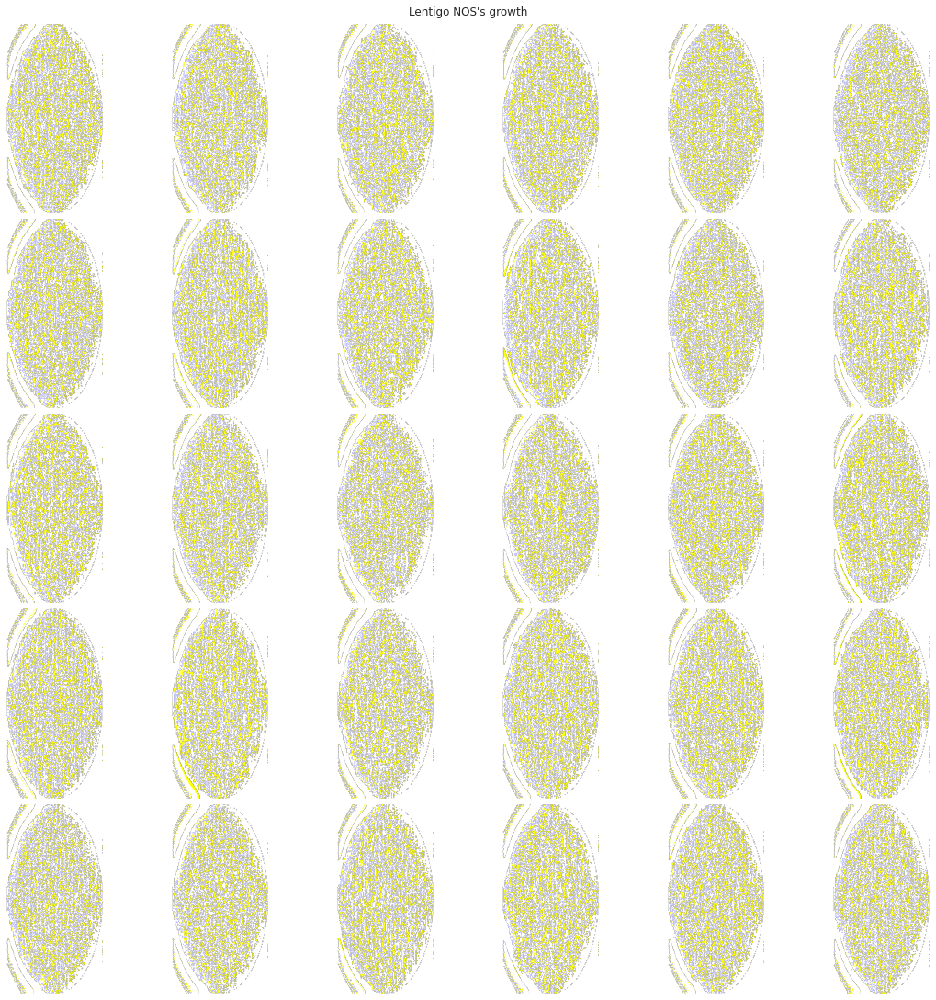

In [ ]:
import pywt
def crop_image_from_gray(img,tol=7):
    if img.ndim ==2:
        mask = img>tol
        return img[np.ix_(mask.any(1),mask.any(0))]
    elif img.ndim==3:
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        mask = gray_img>tol
        
        check_shape = img[:,:,0][np.ix_(mask.any(1),mask.any(0))].shape[0]
        if (check_shape == 0): # image is too dark so that we crop out everything,
            return img # return original image
        else:
            img1=img[:,:,0][np.ix_(mask.any(1),mask.any(0))]
            img2=img[:,:,1][np.ix_(mask.any(1),mask.any(0))]
            img3=img[:,:,2][np.ix_(mask.any(1),mask.any(0))]
            img = np.stack([img1,img2,img3],axis=-1)
        return img
    
def circle_crop(img, sigmaX=10):   
    """
    Create circular crop around image centre    
    """    
    
    img = crop_image_from_gray(img)    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    height, width, depth = img.shape    
    
    x = int(width/2)
    y = int(height/2)
    r = np.amin((x,y))
    
    circle_img = np.zeros((height, width), np.uint8)
    cv2.circle(circle_img, (x,y), int(r), 1, thickness=-1)
    img = cv2.bitwise_and(img, img, mask=circle_img)
    img = crop_image_from_gray(img)
    img=cv2.addWeighted ( img,4, cv2.GaussianBlur( img , (0,0) , sigmaX) ,-4 ,128)
    return img 

def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 5
    fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout=True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        image= circle_crop(image) # this will create circular crop around image center
        coeffs = pywt.dwt2(image, 'bior1.3') # wavelet(biorthogonal) transform 
        IM1, (IM2, IM3, IM4) = coeffs 
        image = IM2 # Horizontal Details 
        i = im // width
        j = im % width
        axs[i,j].imshow(image) 
        axs[i,j].axis('off')
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

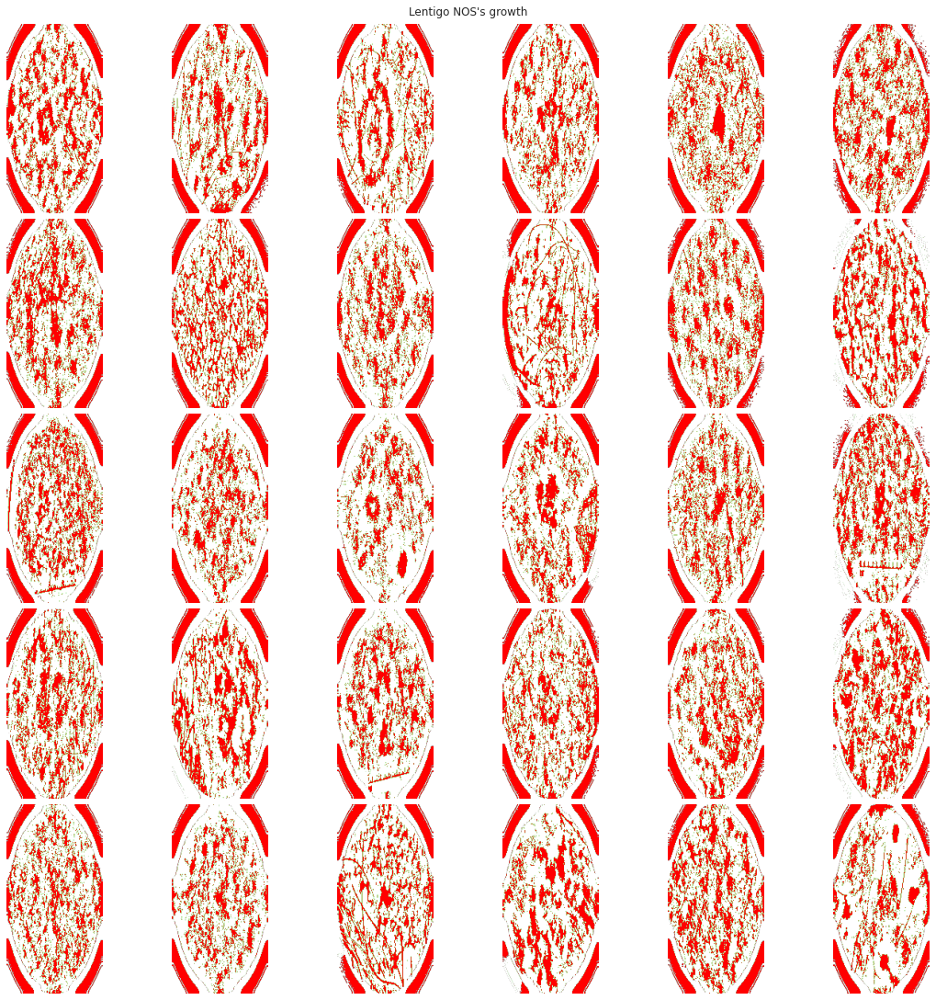

In [ ]:
import pywt
def crop_image_from_gray(img,tol=7):
    if img.ndim ==2:
        mask = img>tol
        return img[np.ix_(mask.any(1),mask.any(0))]
    elif img.ndim==3:
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        mask = gray_img>tol
        
        check_shape = img[:,:,0][np.ix_(mask.any(1),mask.any(0))].shape[0]
        if (check_shape == 0): # image is too dark so that we crop out everything,
            return img # return original image
        else:
            img1=img[:,:,0][np.ix_(mask.any(1),mask.any(0))]
            img2=img[:,:,1][np.ix_(mask.any(1),mask.any(0))]
            img3=img[:,:,2][np.ix_(mask.any(1),mask.any(0))]
            img = np.stack([img1,img2,img3],axis=-1)
        return img
    
def circle_crop(img, sigmaX=10):   
    """
    Create circular crop around image centre    
    """    
    
    img = crop_image_from_gray(img)    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    height, width, depth = img.shape    
    
    x = int(width/2)
    y = int(height/2)
    r = np.amin((x,y))
    
    circle_img = np.zeros((height, width), np.uint8)
    cv2.circle(circle_img, (x,y), int(r), 1, thickness=-1)
    img = cv2.bitwise_and(img, img, mask=circle_img)
    img = crop_image_from_gray(img)
    img=cv2.addWeighted ( img,4, cv2.GaussianBlur( img , (0,0) , sigmaX) ,-4 ,128)
    return img 

def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 5
    fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout=True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        image= circle_crop(image) # # this will create circular crop around image center
        coeffs = pywt.dwt2(image, 'bior1.3') # wavelet(biorthogonal) transform 
        IM1, (IM2, IM3, IM4) = coeffs
        image = IM3 #vertical details
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

# **Hough Transform**

In [ ]:
# def view_images_aug(images, title = '', aug = None):
#     width = 6
#     height = 4
#     fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout=True)
#     for im in range(0, height * width):  
#         data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
#         image = data.pixel_array
#         image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#         image = cv2.resize(image, (256, 256))
        
#         #apply hough transform on the circle cropped image
#         crop_image= circle_crop(image)
# #         crop_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
#         crop_image = cv2.normalize(src=crop_image, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
#         crop_image = cv2.cvtColor(crop_image, cv2.COLOR_RGB2GRAY)    
#     #         print(crop_image.shape)
#         circles = cv2.HoughCircles(crop_image,cv2.HOUGH_GRADIENT,1,20,param1=50,param2=30,minRadius=0,maxRadius=0)
# #         print(circles)
# #         print(f"Circles are : {circles.dtype}")
#         image = np.uint16(np.around(circles))
#         i = im // width
#         j = im % width
#         axs[i,j].imshow(image, cmap=plt.cm.gray) 
#         axs[i,j].axis('off')
#     plt.suptitle(title)
# view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

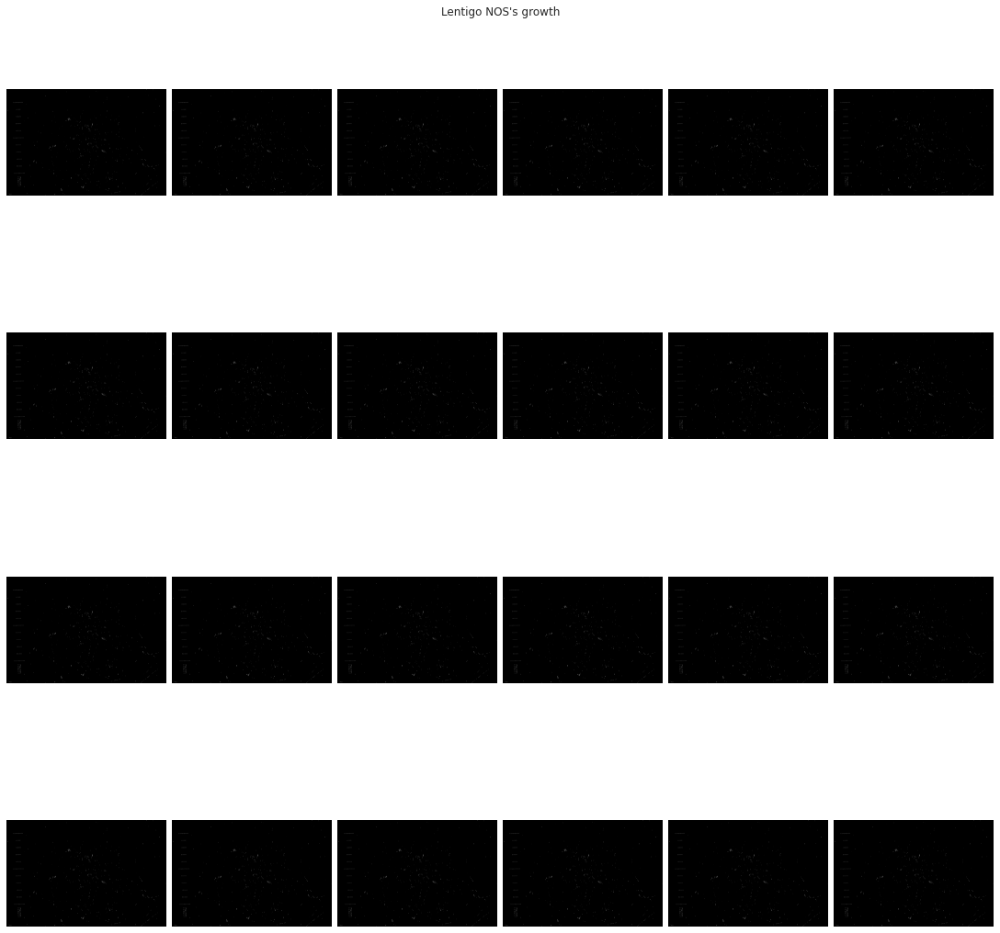

In [ ]:
def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 4
    fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout=True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        image= circle_crop(image)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        edges = cv2.Canny(gray,50,150)

#         lines = cv2.HoughLines(edges,1,np.pi/180,200)
#         for rho,theta in lines[0]:
#             a = np.cos(theta)
#             b = np.sin(theta)
#             x0 = a*rho
#             y0 = b*rho
#             x1 = int(x0 + 1000*(-b))
#             y1 = int(y0 + 1000*(a))
#             x2 = int(x0 - 1000*(-b))
#             y2 = int(y0 - 1000*(a))

#         image = cv2.line(img,(x1,y1),(x2,y2),(0,0,255),2)
        i = im // width
        j = im % width
        axs[i,j].imshow(edges, cmap=plt.cm.gray) 
        axs[i,j].axis('off')
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's growth");

# **Adding Salt and Pepper Noise**

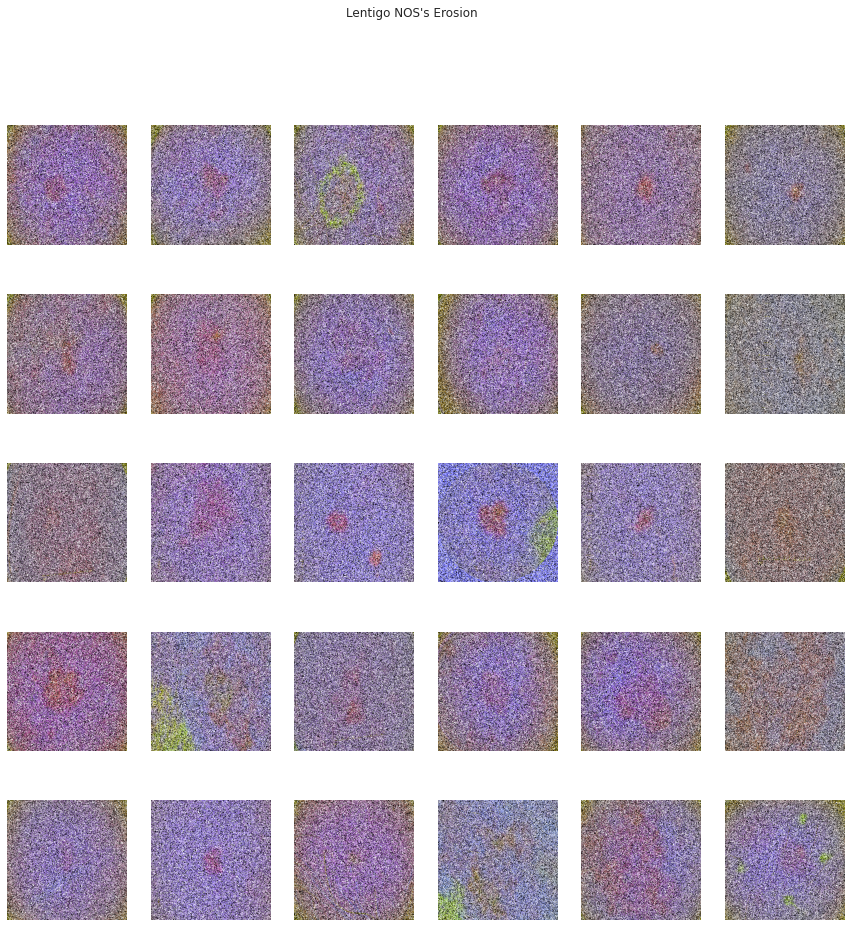

In [ ]:
import random
def sp_noise(image,prob):
    '''
    Add salt and pepper noise to image
    prob: Probability of the noise
    '''
    output = np.zeros(image.shape,np.uint8)
    thres = 1 - prob 
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return output

def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 5
    fig, axs = plt.subplots(height, width, figsize=(15,15))
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (256, 256))
        image = sp_noise(image, 0.192)
        i = im // width
        j = im % width
        axs[i,j].imshow(image, cmap=plt.cm.bone) 
        axs[i,j].axis('off')
        
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's Erosion")

# **Cutout Data Augmentation**
Cutout is a simple regularization technique for convolutional neural networks that involves removing contiguous sections of input images, effectively augmenting the dataset with partially occluded versions of existing samples.

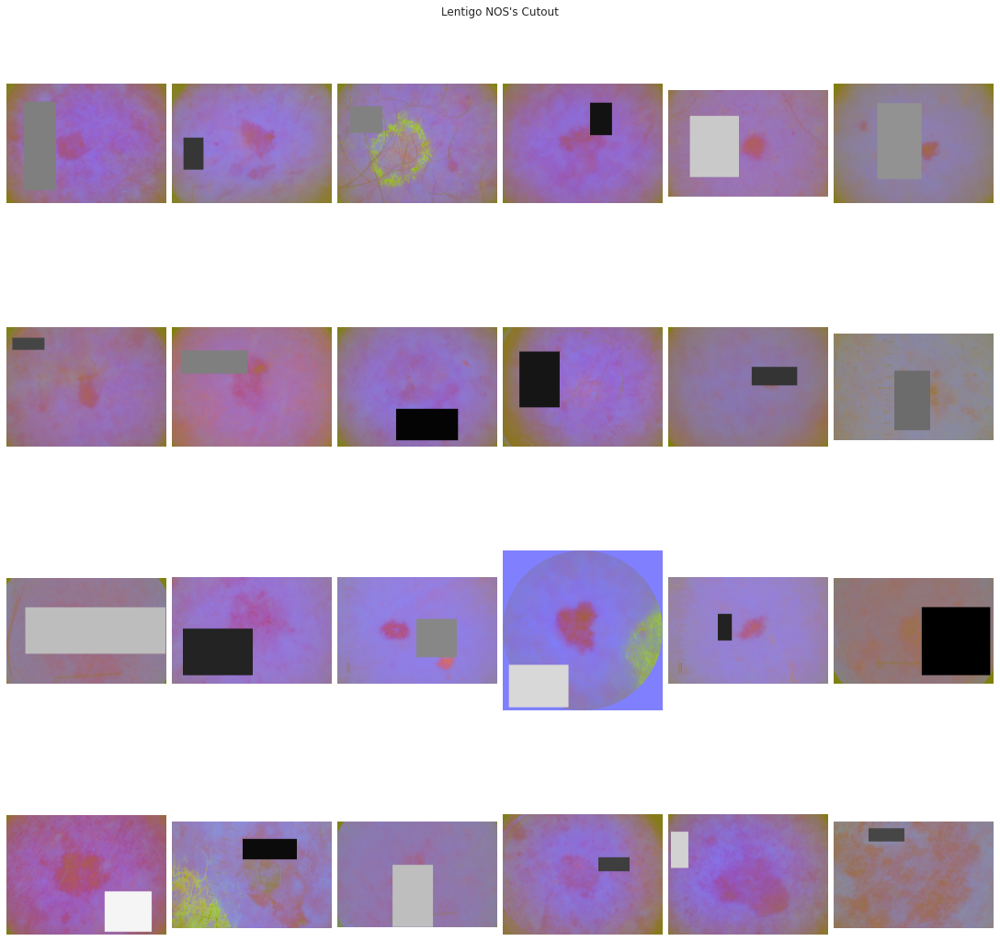

In [ ]:
def get_random_eraser(input_img,p=0.5, s_l=0.02, s_h=0.4, r_1=0.3, r_2=1/0.3, v_l=0, v_h=255, pixel_level=False):
   # def eraser(input_img):
    img_h, img_w, img_c = input_img.shape

    while True:
        s = np.random.uniform(s_l, s_h) * img_h * img_w
        r = np.random.uniform(r_1, r_2)
        w = int(np.sqrt(s / r))
        h = int(np.sqrt(s * r))
        left = np.random.randint(0, img_w)
        top = np.random.randint(0, img_h)

        if left + w <= img_w and top + h <= img_h:
            break

    if pixel_level:
        c = np.random.uniform(v_l, v_h, (h, w, img_c))
    else:
        c = np.random.uniform(v_l, v_h)

    input_img[top:top + h, left:left + w, :] = c

    return input_img

def view_images_aug(images, title = '', aug = None):
    width = 6
    height = 4
    fig, axs = plt.subplots(height, width, figsize=(15,15), constrained_layout = True)
    for im in range(0, height * width):  
        data = pydicom.read_file(os.path.join(train_images_dir, list(images)[im]+ '.dcm'))
        image = data.pixel_array
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = get_random_eraser(image)
#         image = cv2.resize(image, (256, 256))
#         image = sp_noise(image, 0.192)
        i = im // width
        j = im % width
        axs[i,j].imshow(image) 
        axs[i,j].axis('off')
        
    plt.suptitle(title)
view_images_aug(train_df_1[train_df_1['diagnosis']=='lentigo NOS']['image_name'], title="Lentigo NOS's Cutout")

In [ ]:

# image = cv2.imread("../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0015719.jpg")
# gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# print(gray)
# tol = 7
# mask = gray > tol #mask => boolean array
# print(mask)

In [ ]:
# mask.any(1)

In [ ]:
# mask.any(0)

In [ ]:
# my_2d_array = np.arange(start = 1, stop = 7).reshape((2,3))

In [ ]:
# my_2d_array

In [ ]:
# print(my_2d_array.any(0))
# print(my_2d_array.any(1))

In [ ]:
# np.ix_(my_2d_array.any(1),my_2d_array.any(0))

In [ ]:
# my_2d_array[np.ix_(my_2d_array.any(1),my_2d_array.any(0))]